# Stanford Recuritument Challenge
---
## Goal: Porstate Detection/Segmentation in MR Sequences

Prostate cancer is the second most common cause of cancer deaths in males and will afflict 1 in 6 men. Many diagnostic prostate biopsies fail to detect occult cancers because of the difficulty in properly determining the prostate’s anatomy. Approximately 20% of ultrasound image guided prostate biopsies return negative results despite rising levels of prostate-specific antigen (PSA) markers in the blood and the presence of cancer somewhere in the 30+ cc gland. These failures have been attributed by some to the hesitation to sample one of the two major parts of the glands— namely the predilection toward the more easily reached peripheral zone (PZ) over the less accessible central gland (CG). This year’s ISBI challenge contestants outlined these two non-overlapping adjacent regions of the gland (see image).

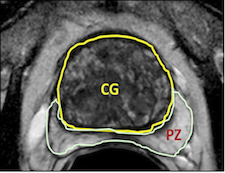
    
    
## Hypothesis:

-  Advancing solutions to this vexing clinical problem will raise awareness about the impact computer image processing can have toward addressing a widespread, critical healthcare puzzle. 


## Input:
Training and test data:
- A 60-case prostate MRI 3D series "training set" consisting of Digital Imaging and Communications in Medicine (DICOM) images with matched NRRD markups that define the tissue CG and PZ are available from the NCI via The Cancer Imaging Archive (TCIA).
- There will be 60 cases, each consisting of 15+ (4 mm thick slices at 3T) or 28+ (3 mm thick at 1.5T) adjacent axial cross-section cuts. 
- Half of them were obtained at 1.5 T (Philips Achieva) with an endo-rectal receiver coil (fromBostonMedicalCenter) and the other half at 3T (Siemens TIM) with a surface coil (from Radboud University Nijmegen Medical Centre [RUNMC],Netherlands)
- They were acquired as T2-weighted MR axial pulse sequences. Each file contains nearly all DICOM acquisition parameters except tags that specifically identify Private Health Information. 
- The 10-case prostate MRI 3D series "test set" is now available via direct download: http://challenge.kitware.com/midas/item/3046.


## Output:
- The final system shall take an image as input, and output either „AP“ or „lateral“ as image type.

---
# Method

To segment the prostate, we can think of two standard approaches.
- **One-stage - Direct segmentation:** after observation we noticed that in all volumes prostate located almost in the center of MR images. On the other hand for the model, we need a fixed-size input so to tackle this issue, what we could do is to apply **centr-cropping** and extract region-of-interest (RoIs) with a fixed-size for example 256x256.

- **Multi-stage - First detect then segment:** In this approach, we can run a very shallow auto-encoder to generate very rough segmentation of the input images in a smaller resolutions, then use the predicted output as a landarmark to corp the RoIs in the high-resolution images. This method is more clinically-relevant, since there is chances that the prostate located not in center of the MR images.


**Note:** for the sake of this challenge we employed the first apporach.

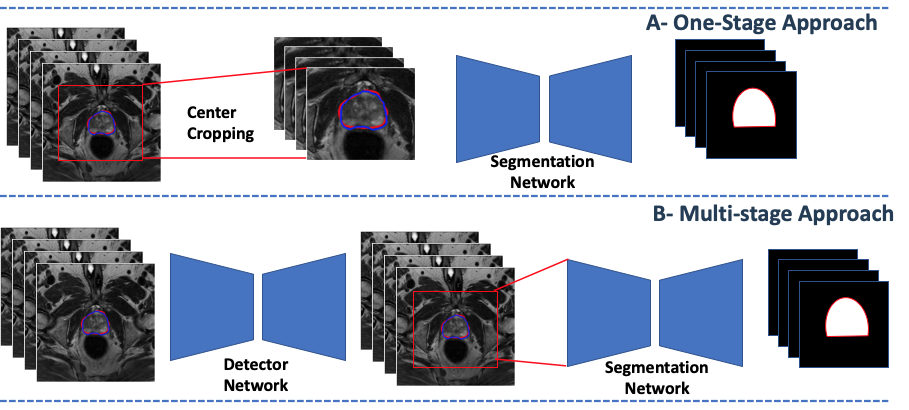

---
# Model Archticture

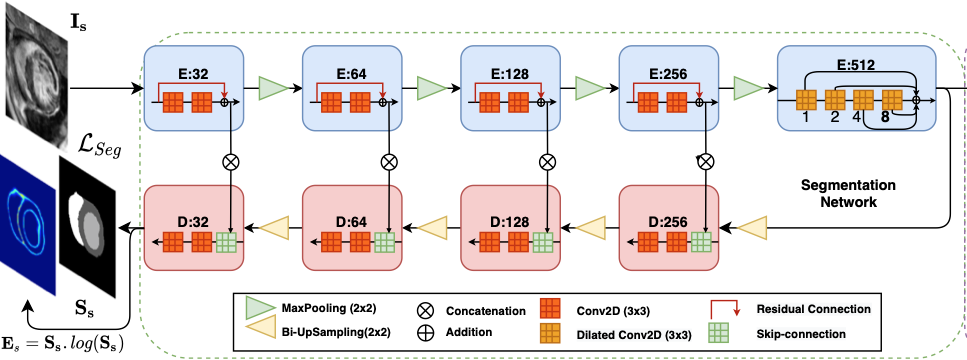{ width=50% }


---
# Data Split

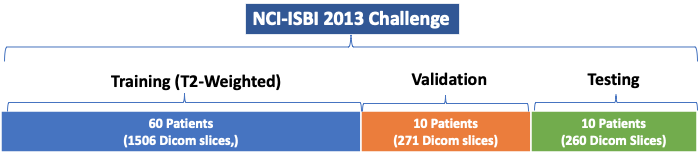

---
# Evaluation

**Dice coefficient**: Computes the Dice coefficient (also known as Sorensen index) between the binary objects in two images.

The metric is defined as : $$ DC=\frac{2|A∩B|}{|A|+|B|}$$
where $A$ is the ground-truth and $B$ is the model predictions.

**Hausdorff Distance**: Computes the (symmetric) Hausdorff Distance (HD) between the binary objects in two images. It is defined as the maximum surface distance between the objects.

---
### Note: To re-run the notebook without python packaging problem, use ```enviroment.yml ``` file

Use the ```terminal/Anaconda Prompt/Juupyter Notebook``` for the following steps:

- Create the environment from the environment.yml file: ```conda env create -f environment.yml```

- The first line of the yml file sets the new environment's name. Here the name is: ```"pipleine_test"```

- Activate the new environment: ```conda activate pipleine_test```

- Verify that the new environment was installed correctly: ```conda env list```

---
# 1. Exploratory Data Analysis

In [3]:
"""
@Author: Sulaiman Vesal
Date: Tuesday, 04, 2021

"""

import warnings
warnings.filterwarnings("ignore")

#import tensorflow as tf
import os
import sys
import cv2
import nrrd
import medpy
import pickle
import random
import scipy.misc
import numpy as np
import scipy.ndimage
import pydicom as dicom
from glob import glob


import torch
import matplotlib.pyplot as plt
from livelossplot import PlotLosses
import torch as t
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.tensorboard import SummaryWriter
from datetime import datetime
import argparse
from utils.utils import soft_to_hard_pred, keep_largest_connected_components
from utils.loss import DiceCoefMultilabelLoss
from model.dilated_unet import Segmentation_model
from utils.callbacks import EarlyStoppingCallback, ModelCheckPointCallback
from utils.metric import dice_coef_multilabel
#from dataset import ImageProcessor, DataGenerator

---
## 1.1 Utils Functions for Exploratory Data Aanalysis
Here, we have some utility functions for:
- Reading and writing the dicom files
- Reading and writing the annotation files which are in NRRD fomrat
- Visualize the images and their corresponding segmentations
- Visualize and find mis-placed DICOM images, some of the slices are not in correct order.
- Prepare the data

Before            |  After
:-------------------------:|:-------------------------:
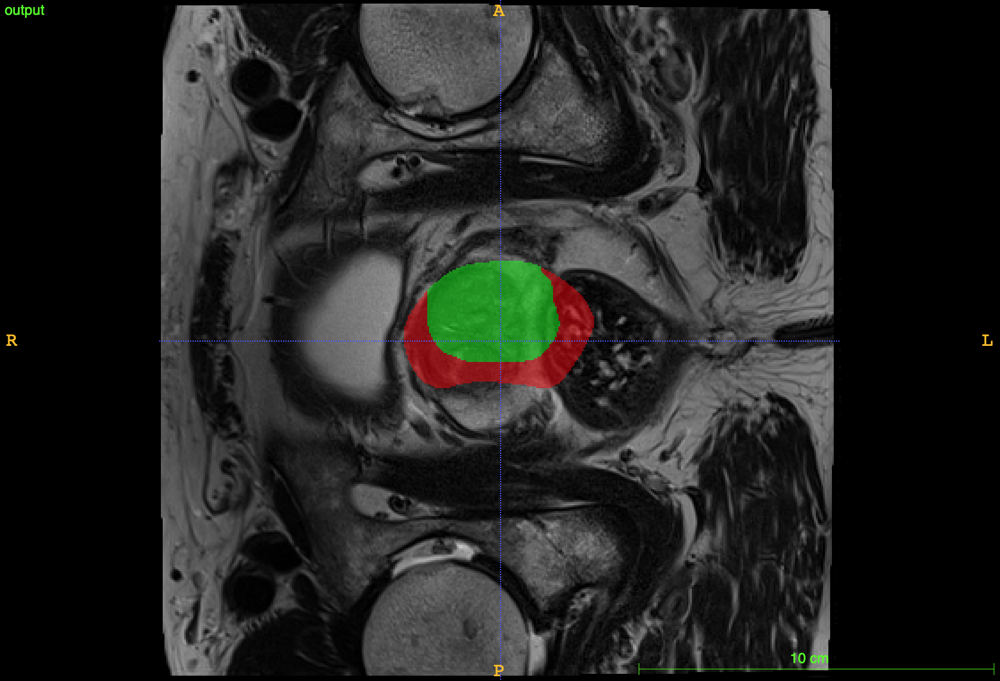  | 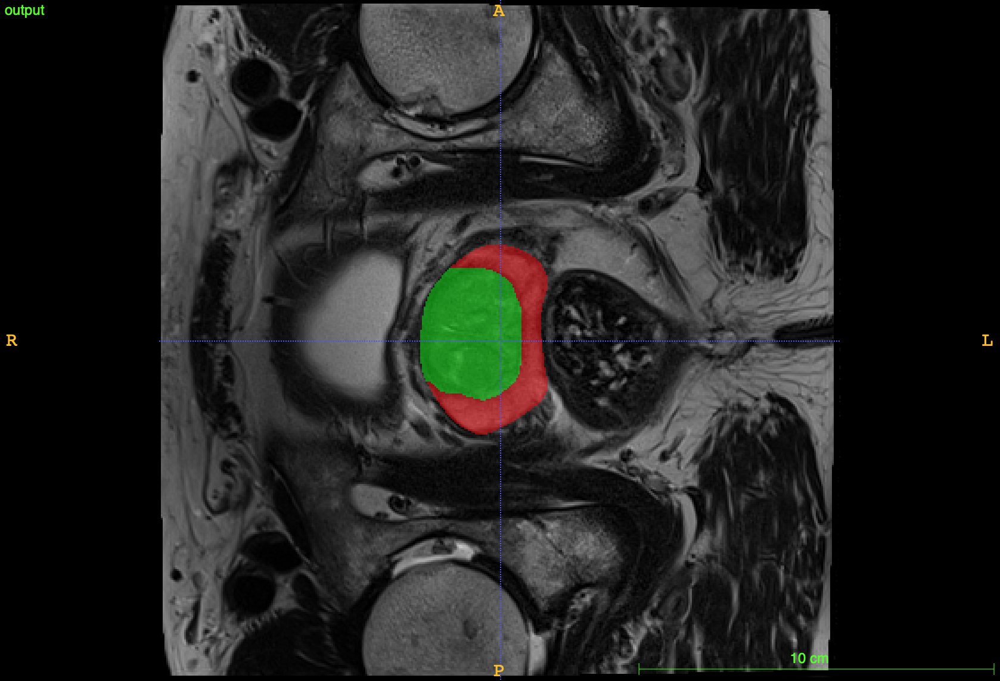

In [143]:
def get_slice_location(dcm):
    """ 
    Reutrn dicom slice location.
    
        dcm: Dicom File
    """
    return float(dcm[0x0020, 0x1041].value)

def convert(img, 
            target_type_min, 
            target_type_max, 
            target_type):
    """ 
    Normalize input image using min-max normalisation approach.
    
        img: input image
        target_type_min: the minimum pixel value
        target_type_max: the maximum pixel value
        target_type: the array type e.g. np.unit8
    """
    imin = img.min()
    imax = img.max()

    a = (target_type_max - target_type_min) / (imax - imin)
    b = target_type_max - a * imax
    new_img = (a * img + b).astype(target_type)
    return new_img


def overlay_image(main, 
                  seg, 
                  pred=None):
    """ 
    Overlay segmentation output on the image
    
        img: input image e.g. Prostate MRI Slice
        seg: segmentation mask
        pred: whether we should overlay the prediction or not
    """
    # Load images as greyscale but make main RGB so we can annotate in colour
    main = cv2.cvtColor(main,cv2.COLOR_GRAY2BGR)
    
    seg = np.array(seg).astype(np.uint8)
    if pred is not None:
        pred = np.array(pred).astype(np.uint8)

    # Dictionary giving RGB colour for label (segment label) - label 1 in red, label 2 in yellow
    RGBforLabel = { 1:(0,255,255) }

    # Find external contours
    contours,_ = cv2.findContours(seg,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)

    # Iterate over all contours
    for i,c in enumerate(contours):
        # Find mean colour inside this contour by doing a masked mean
        mask = np.zeros(seg.shape, np.uint8)
        cv2.drawContours(mask,[c],-1,255, -1)

        # Get appropriate colour for this label
        #label = 1 if mean > 1.0 else 1
        colour = RGBforLabel.get(1)
        # Outline contour in that colour on main image, line thickness=1
        cv2.drawContours(main,[c],-1,colour,1)
        
    if pred is not None:
        # Dictionary giving RGB colour for label (segment label) - label 1 in red, label 2 in yellow
        RGBforLabel = { 1:(0,0,255) }

        # Find external contours
        contours,_ = cv2.findContours(pred,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)

        # Iterate over all contours
        for i,c in enumerate(contours):
            # Find mean colour inside this contour by doing a masked mean
            mask = np.zeros(seg.shape, np.uint8)
            cv2.drawContours(mask,[c],-1,255, -1)
            # DEBUG: cv2.imwrite(f"mask-{i}.png",mask)
            mean,_,_,_ = cv2.mean(seg, mask=mask)
            # DEBUG: print(f"i: {i}, mean: {mean}")

            # Get appropriate colour for this label
            #label = 1 if mean > 1.0 else 1
            colour = RGBforLabel.get(1)
            # Outline contour in that colour on main image, line thickness=1
            cv2.drawContours(main,[c],-1,colour,1)
    
    return main


def plot_images(images, 
                masks, 
                sample_toshow = 10, 
                phase='train'):
    """ 
    Plot images and masks 
    
        images: input image e.g. Prostate MRI Slice
        masks: segmentation masks
    """
    masks_binary = np.where(masks>0, 1, 0)
    
    count = 0
    i = 0
    fig,axs = plt.subplots(sample_toshow,5, figsize=(20,50))
    for i in range(sample_toshow):
        
        #k = random.randint(1,sample_toshow)
        k = i
        img = images [k]
        binary = masks_binary[k]
        mask = masks[k]

        axs[count][0].title.set_text("Prostate MRI")
        axs[count][0].imshow(img, cmap='gray')
        
        axs[count][1].title.set_text("Histo Intensities")
        axs[count][1].hist(img.ravel())

        axs[count][2].title.set_text("Mask")
        axs[count][2].imshow(mask, cmap='jet')
        
        axs[count][3].title.set_text("Binary Mask")
        axs[count][3].imshow(binary, cmap='gray')

        #img[binary==1] = 255  # change pixel color at the position of mask
        axs[count][4].title.set_text("MRI with Mask")
        axs[count][4].imshow(overlay_image(convert(img, 0, 255, np.uint8), convert(binary, 0, 1, np.uint8)))
        count +=1

    #plt.suptitle("Random {} images".format(phase), fontsize=24)
    plt.show()
    fig.tight_layout() 

def plot_images_series(images, 
                       masks, 
                       phase='train'):
    """ 
    Plot a sequence of image volume to see if the images and masks are in ocrrect order or not. 
    
        images: input image e.g. Prostate MRI Slice
        masks: segmentation masks
    """

    f, plots = plt.subplots(4, 5, sharex='col', sharey='row', figsize=(18, 12))
    for i in range(20):
        img = images[i, :, :]
        msk = masks[i, :, :]
        plots[i // 5, i % 5].axis('off')
        plots[i // 5, i % 5].imshow(img, cmap=plt.cm.gray)
        plots[i // 5, i % 5].imshow(msk, cmap=plt.cm.jet, alpha =0.6)
        plots[i // 5, i % 5].set_title(str(i))
    plt.suptitle("Random {} images".format(phase), fontsize=24)
    plt.show()
    plt.tight_layout()
    

def return_dcm(file_path, 
               check_term = 'Prostate'):
    """
    Read all DCM (slices) files within a directory and order the files based on filename
    """
    out_dcm = {}
    for dirName, subdirList, fileList in os.walk(file_path):
        c_dcm = []
        cur_name = ""
        dir_split = dirName.split("/")
        for f_chk in dir_split:
            if check_term in f_chk:
                cur_name = f_chk
        for filename in fileList:
            if ".dcm" in filename.lower():
                name = os.path.splitext(filename)[0]
                c_dcm.append((os.path.join(dirName,filename), name))
        if len(c_dcm) > 0:
            c_dcm = sorted(c_dcm, key = lambda t: t[1]) # Sort into correct order
            out_dcm[cur_name] = [c[0] for c in c_dcm]   # Store in dictionary
    return out_dcm

def return_nrrd(file_path):
    """
    Read all NRRD (annotation) files within a directory
    """

    out_nrrd = {}
    for dirName, subdirList, fileList in os.walk(file_path):
        for filename in fileList:
            if ".nrrd" in filename.lower():
                name = filename.split('_')[0] 
                name = name.split('.')[0] # Get annotation name and store in dictionary
                out_nrrd[name] = os.path.join(dirName,filename)
    return out_nrrd

def save_npy(image, 
             mask, 
             filename, 
             dir_name):
    
    """
    Save NRRD and DCM file as npy for faster prototyping
    :param vol:
    :return:
    """
    for i in range(len(image)):
        np.save("../input/{}/{}_{:0>2d}.npy".format(dir_name,filename, int(i+1)), image[i])
        np.save("../input/{}/{}_{:0>2d}_seg.npy".format(dir_name, filename, int(i+1)), mask[i])
        
        
def path_to_csv():
    
    df_train = pd.DataFrame(columns=['img'])
    df_valid = pd.DataFrame(columns=['img'])

    df_train['img'] = sorted(glob("../input/train_npy/*_seg.npy"))
    df_valid['img'] = sorted(glob("../input/valid_npy/*_seg.npy"))
    
    print(df_train.head(20))
    df_train.to_csv("trainA1.csv")
    df_valid.to_csv("validA1.csv")
    

def rotate_flip_mask(image):
    """
    # Rotate and flip annotations to match volumes
    """
    image = scipy.ndimage.interpolation.rotate(image, 90, reshape = False)
    for k in range(np.shape(image)[2]):
        cur_img = np.squeeze(image[:, :, k])
        image[:, :, k] = np.flipud(cur_img)
        
    return image
        
    
def crop_volume(vol, 
                crop_size=112):
    """
    :param vol:
    :return:
    """
    return np.array(vol[
                    int(vol.shape[0] / 2) - crop_size: int(vol.shape[1] / 2) + crop_size,
                    int(vol.shape[0] / 2) - crop_size: int(vol.shape[1] / 2) + crop_size,: ])

def pad_volume(vol, 
               new_shape, 
               crop_size=128):
    """
    :param vol:
    :return:
    """
    new_imge = np.zeros(new_shape, dtype=vol.dtype)
    new_imge[int(new_imge.shape[0] / 2) - crop_size: int(new_imge.shape[1] / 2) + crop_size,
             int(new_imge.shape[0] / 2) - crop_size: int(new_imge.shape[1] / 2) + crop_size,: ] = vol
    
    return new_imge


def get_dataset(data_dir, 
                anns_dir, 
                npy= True, 
                dir_name= "train_npy", 
                crop=True, 
                crop_size = 128):
    """
    Match DCM volumes with corresponding annotation files
    :param vol:
    :return:
    """
    data_out = []
    mask_out = []
    shapes = {}
    d_dcm = return_dcm(data_dir)
    d_nrrd = return_nrrd(anns_dir)
    
    for i in d_nrrd:
        if i == 'ProstateDx-01-0035' or i == 'ProstateDx-01-0055':
            continue
            
        seg, opts = nrrd.read(d_nrrd[i])
        voxels = np.zeros(np.shape(seg))
        
        for j in range(len(d_dcm[i])):
            dicom_ref = dicom.read_file(d_dcm[i][j])
            chk_val = dicom_ref[("0020", "0013")].value 
            # Make sure you get the right slice! This is a bizarre specification thing related to DCM dataset
            # Note, if you just use the default filename ordering you get mismatched slices!
            if int(chk_val.__str__()) - 1 < np.shape(voxels)[-1]:
                voxels[:, :, int(chk_val.__str__()) - 1] = dicom_ref.pixel_array
            else: 
                print('Index: ',str(int(chk_val.__str__()) - 1), ' too large for ', i, ' skipping!')
        
        # Rotate and flip annotations to match volumes
        seg = rotate_flip_mask(seg)

        # Center crop images and masks        
        if crop:
            voxels = crop_volume(voxels, crop_size = crop_size)
            seg = crop_volume(seg, crop_size = crop_size)

        voxels = np.moveaxis(voxels, 2,0)
        seg = np.moveaxis(seg, 2,0)
        
        if npy:
            save_npy(voxels, seg, i, dir_name)
            
        data_out.extend(voxels)
        mask_out.extend(seg)
    return (data_out, mask_out)


def get_test_dataset(data_dir, 
                     anns_dir, 
                     npy= True, 
                     dir_name= "train_npy", 
                     crop=True,
                     crop_size = 128):
    """
    Match DCM volumes with corresponding annotation files
    :param vol:
    :return:
    """
    data_out = []
    mask_out = []
    d_dcm = glob(os.path.join(data_dir + '*/*/*.dcm'))
    d_nrrd = anns_dir
    
    seg, opts = nrrd.read(d_nrrd)
    voxels = np.zeros(np.shape(seg))
    
    outshape = np.shape(seg)
    
    for j in range(len(d_dcm)):
        dicom_ref = dicom.read_file(d_dcm[j])
        chk_val = dicom_ref[("0020", "0013")].value 
        # Make sure you get the right slice! This is a bizarre specification thing related to DCM dataset
        # Note, if you just use the default filename ordering you get mismatched slices!
        if int(chk_val.__str__()) - 1 < np.shape(voxels)[-1]:
            voxels[:, :, int(chk_val.__str__()) - 1] = dicom_ref.pixel_array
        else: 
            print('Index: ',str(int(chk_val.__str__()) - 1), ' too large for ', j, ' skipping!')

    # Rotate and flip annotations to match volumes
    seg = rotate_flip_mask(seg)

    # Center crop images and masks
    if crop:
        voxels = crop_volume(voxels, crop_size = crop_size)
        seg = crop_volume(seg, crop_size = crop_size)

    voxels = np.moveaxis(voxels, 2,0)
    seg = np.moveaxis(seg, 2,0)
    return voxels, seg, opts, outshape

In [146]:
#
# Functions to process files, directories and metrics
#
def metrics(img_gt, img_pred, voxel_size):
    
    """
    Adapted: https://www.creatis.insa-lyon.fr/Challenge/acdc/code/metrics_acdc.py
    
    Function to compute the metrics between two segmentation maps given as input.

    Parameters
    ----------
    img_gt: np.array
    Array of the ground truth segmentation map.

    img_pred: np.array
    Array of the predicted segmentation map.

    voxel_size: list, tuple or np.array
    The size of a voxel of the images used to compute the volumes.

    Return
    ------
    A list of metrics in this order, [Dice LV, Volume LV, Err LV(ml),
    Dice RV, Volume RV, Err RV(ml), Dice MYO, Volume MYO, Err MYO(ml)]
    """

    if img_gt.ndim != img_pred.ndim:
        raise ValueError("The arrays 'img_gt' and 'img_pred' should have the "
                         "same dimension, {} against {}".format(img_gt.ndim,
                                                                img_pred.ndim))

    res = []
    # Loop on each classes of the input images
    for c in [1]:
        # Copy the gt image to not alterate the input
        gt_c_i = np.copy(img_gt)
        gt_c_i[gt_c_i != c] = 0

        # Copy the pred image to not alterate the input
        pred_c_i = np.copy(img_pred)
        pred_c_i[pred_c_i != c] = 0

        # Clip the value to compute the volumes
        gt_c_i = np.clip(gt_c_i, 0, 1)
        pred_c_i = np.clip(pred_c_i, 0, 1)

        # Compute the Dice
        dice = medpy.metric.binary.dc(gt_c_i, pred_c_i)
        
        # Compute the Housdurf distance
        hdd = medpy.metric.binary.hd(gt_c_i, pred_c_i)
        
        # Compute the Housdurf distance
        sen = medpy.metric.binary.sensitivity(gt_c_i, pred_c_i)
        
        # Compute the Housdurf distance
        spe = medpy.metric.binary.specificity(gt_c_i, pred_c_i)
        
        # Compute the Dice
        # Computes the linear correlation in binary object volume between the contents 
        # of the successive binary images supplied. Measured through the 
        # Pearson product-moment correlation coefficient.
        vol, p_value = medpy.metric.binary.volume_correlation(gt_c_i, pred_c_i)
        
        # Compute volume
        volpred = pred_c_i.sum() * np.prod(voxel_size) / 1000.
        volgt = gt_c_i.sum() * np.prod(voxel_size) / 1000.

        res += [dice, hdd, sen, spe, vol, p_value]

    return res

def compute_metrics_on_files(path_gt, gt, pred, zooms, header=True):
    """
    Function to give the metrics for two files

    Parameters
    ----------

    path_gt: string
    Path of the ground truth image.

    path_pred: string
    Path of the predicted image.
    """
    
    HEADER = ["Name                   ", "Dice [%] ", "HD [mm]", 
              "Sensitivity [%]", "Specificity [%]", "Vol-Corr ", "P-Value"]
    
    name = os.path.basename(path_gt)
    name = name.split('.')[0]
    res = metrics(gt, pred, zooms)
    res = ["{:.3f}".format(r) for r in res]

    formatting = "{:>8}, {:>8}, {:>10}, {:>10}, {:>10}, {:>10},  {:>10}"
    if header:
        print(formatting.format(*HEADER))
    print(formatting.format(name, *res))
    
    return name


def plot_history(history_path):
    """
    Plot the training curves for loss and dice meterics.
    """
    
    history = pd.read_csv(history_path)
    plt.figure(figsize=(15,5))
    
    n_e = np.arange(len(history['dice_coe']))
    plt.plot(n_e,history['dice_coe'],'-o',label='Train dice_coe',color='#ff7f0e')
    plt.plot(n_e,history['val_dice_coe'],'-o',label='Val dice_coe',color='#1f77b4')
    x = np.argmax( history['val_dice_coe'] ); y = np.max( history['val_dice_coe'] )
    xdist = plt.xlim()[1] - plt.xlim()[0]; ydist = plt.ylim()[1] - plt.ylim()[0]
    plt.scatter(x,y,s=200,color='#1f77b4'); plt.text(x-0.03*xdist,y-0.13*ydist,'max dice_coe\n%.2f'%y,size=14)
    plt.ylabel('dice_coe',size=14); plt.xlabel('Epoch',size=14)
    plt.legend(loc=2)
    
    plt2 = plt.gca().twinx()
    plt2.plot(n_e,history['loss'],'-o',label='Train Loss',color='#2ca02c')
    plt2.plot(n_e,history['val_loss'],'-o',label='Val Loss',color='#d62728')
    x = np.argmin( history['val_loss'] ); y = np.min( history['val_loss'] )
    ydist = plt.ylim()[1] - plt.ylim()[0]
    plt.scatter(x,y,s=200,color='#d62728'); plt.text(x-0.03*xdist,y+0.05*ydist,'min loss',size=14)
    plt.ylabel('Loss',size=14)
    plt.legend(loc=3)
    plt.show()

---
## 1.2 Load the Data
Here, we are loading the test/valid/train images from the disk and compute some stats to know the number of images for each dataset


In [144]:
# .dcm T2-weighted MRI
data_train_dir = '../../Stanford_coding_challenge/input2/train/'              
data_leader_dir = '../../Stanford_coding_challenge/input2/valid/' 
data_test_dir = '../../Stanford_coding_challenge/input2/test/'

# .nrrd annotation files
anns_train_dir = '../../Stanford_coding_challenge/input2/train-segm/'         
anns_leader_dir = '../../Stanford_coding_challenge/input2/valid-segm/'   
anns_test_dir = '../../Stanford_coding_challenge/input2/test-segm/'          

train = get_dataset(data_train_dir, anns_train_dir, npy = False, dir_name = "train_npy")
valid = get_dataset(data_leader_dir, anns_leader_dir, npy = False, dir_name = "valid_npy")
test = get_dataset(data_test_dir, anns_test_dir, npy = False, dir_name = None)

print("\nTraining scans:", len(train[0]),  
      "\nValidation scans:", len(valid[0]), 
      "\nTesting scans: ", len(test[0]),)
print("Sample 3D scans' shapes:", np.array(train[0]).shape, np.array(valid[0]).shape, np.array(test[0]).shape) # as we can see these shapes vary


Training scans: 1483 
Validation scans: 261 
Testing scans:  271
Sample 3D scans' shapes: (1483, 256, 256) (261, 256, 256) (271, 256, 256)


In [144]:
path_to_csv()

                                                 img
0   ../input/train_npy/Prostate3T-01-0001_01_seg.npy
1   ../input/train_npy/Prostate3T-01-0001_02_seg.npy
2   ../input/train_npy/Prostate3T-01-0001_03_seg.npy
3   ../input/train_npy/Prostate3T-01-0001_04_seg.npy
4   ../input/train_npy/Prostate3T-01-0001_05_seg.npy
5   ../input/train_npy/Prostate3T-01-0001_06_seg.npy
6   ../input/train_npy/Prostate3T-01-0001_07_seg.npy
7   ../input/train_npy/Prostate3T-01-0001_08_seg.npy
8   ../input/train_npy/Prostate3T-01-0001_09_seg.npy
9   ../input/train_npy/Prostate3T-01-0001_10_seg.npy
10  ../input/train_npy/Prostate3T-01-0001_11_seg.npy
11  ../input/train_npy/Prostate3T-01-0001_12_seg.npy
12  ../input/train_npy/Prostate3T-01-0001_13_seg.npy
13  ../input/train_npy/Prostate3T-01-0001_14_seg.npy
14  ../input/train_npy/Prostate3T-01-0001_15_seg.npy
15  ../input/train_npy/Prostate3T-01-0002_01_seg.npy
16  ../input/train_npy/Prostate3T-01-0002_02_seg.npy
17  ../input/train_npy/Prostate3T-01-0002_03_s

---
## 1.3 Plot a Volume
We plot a volume to see if we could correct the Dicom slice orders or not and get some insights on how the data look-like.

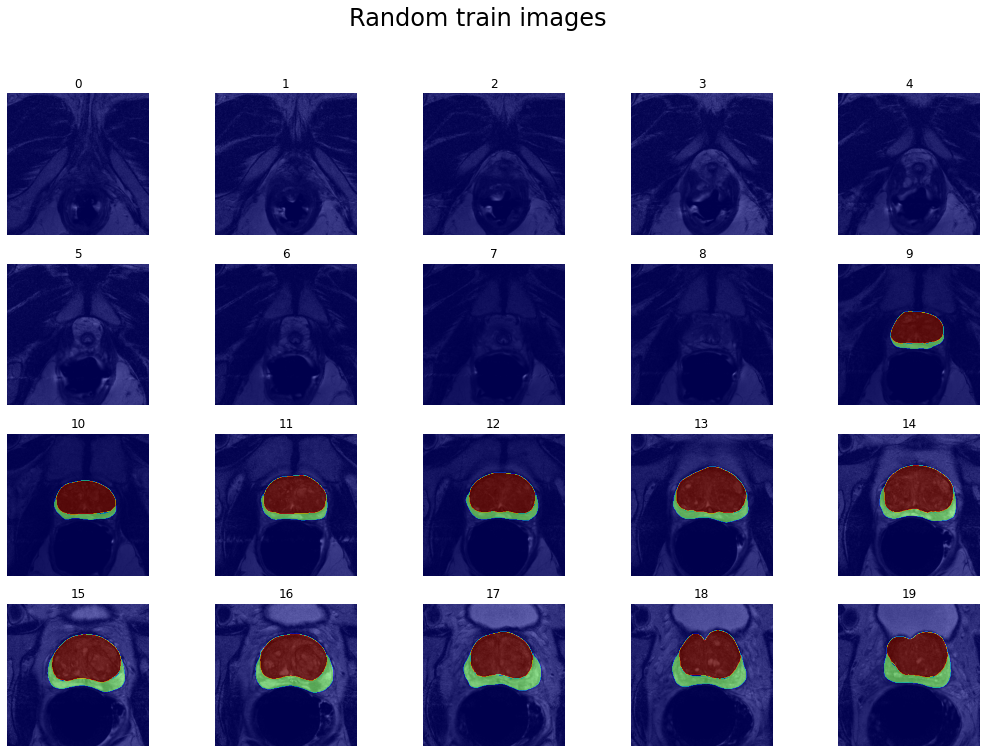

<Figure size 432x288 with 0 Axes>

In [145]:
plot_images_series(np.array(valid[0]), np.array(valid[1]))

---
## 1.4 Plot Random MRIs and Histogram
Before doing any preprocessing, let's see some stats about the images from random patients. 

- From histogram of the images, it can be seen that images have different range of values
- The contrast of MRI images are very low
- After overlaying the annotation masks on the images, still we can see that some of the annotations are not correct or shifted
- Since, our task is to detect prostate wihtin MRI, we transfomed the segmentation masks to binary after merging the AG and ER classes.

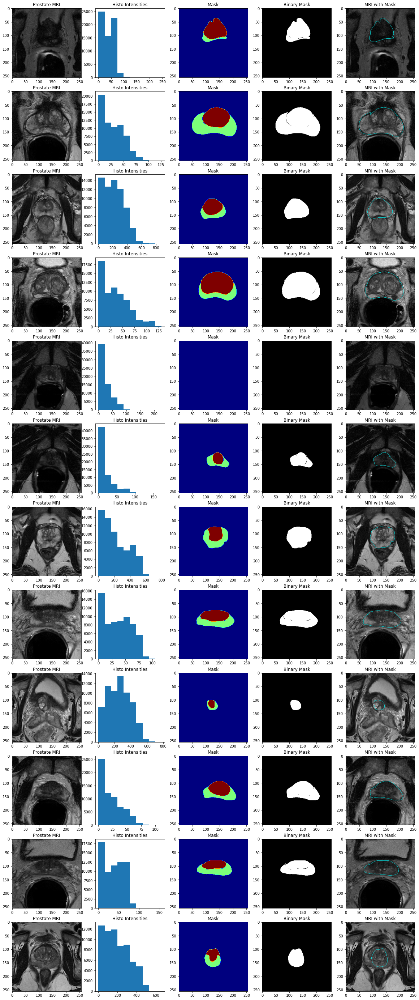

In [131]:
plot_images(np.array(valid[0]), np.array(valid[1]))

---
# 2. Create DataLoader

The dataloader has the following components:

1. Reading the converted Dicom and NRRD files from the disk.
2. Apply center cropping to make the model input size fix across every patients
3. Normalize the data, using min-max algorightm to trasnform the image intensities range to [0,1]
4. Applying random data aguementation using **Albumentations** libarary for training data
5. We also apply **Contrast Adaptive Histogram Equalisation (CLAHE)** for both training and testing data to increase the image contrast.


**Note:** Since our model is going to segment the prostate in 2D, we really didn't apply any interpolation to fix the slice-thickness of images into consideration. However, if we had the 3D model, then image interpolation was necessary. 

In [5]:
"""
@Author: Sulaiman Vesal
Date: Tuesday, 04, 2020

"""
import numpy as np
import cv2
import pandas as pd
from skimage.exposure import match_histograms
from matplotlib import pyplot as plt
from albumentations import (
    PadIfNeeded,
    HorizontalFlip,
    VerticalFlip,
    CenterCrop,
    Crop,
    Compose,
    Transpose,
    RandomRotate90,
    ElasticTransform,
    GridDistortion,
    OpticalDistortion,
    RandomSizedCrop,
    OneOf,
    CLAHE,
    RandomBrightnessContrast,
    RandomGamma,
    GaussNoise
)
#from keras.utils import to_categorical

class ImageProcessor:
    """
    A class for data preprocessing
    """
    @staticmethod
    
    """
    Creating a set of transformation using albumentations libarary for data augmentation.
    This libabary is fast and give the user high contorl on type of transformation.
    
    https://albumentations.ai/docs/examples/pytorch_semantic_segmentation/
    """
    def augmentation(image, mask, noise=False, transform=False, clahe=True, r_bright=True, r_gamma=True):
        aug_list = [
            VerticalFlip(p=0.5),
            HorizontalFlip(p=0.5),
            RandomRotate90(p=0.5),
                    ]
        if r_bright:
            aug_list += [RandomBrightnessContrast(p=.5)]
        if r_gamma:
            aug_list += [RandomGamma(p=.5)]
        if clahe:
            aug_list += [CLAHE(p=1., always_apply=True)]
        if noise:
            aug_list += [GaussNoise(p=.5, var_limit=1.)]
        if transform:
            aug_list += [ElasticTransform(p=.5, sigma=1., alpha_affine=20, border_mode=0)]
        aug = Compose(aug_list)

        augmented = aug(image=image, mask=mask)
        image_heavy = augmented['image']
        mask_heavy = augmented['mask']
        return image_heavy, mask_heavy

    @staticmethod
    def split_data(img_path):
        """
        Load train csv file and split the data into train and validation!
        :return:
        """
        df_train = pd.read_csv(img_path)
        ids_train = df_train['img']
        return ids_train

    @staticmethod
    def crop_volume(vol, crop_size=112):

        """
        :param vol:
        :return:
        """

        return np.array(vol[:,
                        int(vol.shape[1] / 2) - crop_size: int(vol.shape[1] / 2) + crop_size,
                        int(vol.shape[2] / 2) - crop_size: int(vol.shape[2] / 2) + crop_size, ])

class DataGenerator:
    def __init__(self, df,
                 channel="channel_first",
                 apply_noise=False,
                 apply_transform=False,
                 phase="train",
                 apply_online_aug=True,
                 batch_size=16,
                 height=256,
                 width=256,
                 crop_size=0,
                 n_samples=-1,
                 offline_aug=False,
                 toprint=False):
        assert phase == "train" or phase == "valid", r"phase has to be either'train' or 'valid'"
        assert isinstance(apply_noise, bool), "apply_noise has to be bool"
        assert isinstance(apply_online_aug, bool), "apply_online_aug has to be bool"
        self._data = df
        self._len = len(df)
        self._shuffle_indices = np.arange(len(df))
        self._shuffle_indices = np.random.permutation(self._shuffle_indices)
        self._height, self._width = height, width
        self._apply_aug = apply_online_aug
        self._apply_noise = apply_noise
        self._apply_tranform = apply_transform
        self._crop_size = crop_size
        self._phase = phase
        self._channel = channel
        self._batch_size = batch_size
        self._index = 0
        self._totalcount = 0
        if n_samples == -1:
            self._n_samples = len(df)
        else:
            self._n_samples = n_samples
        self._offline_aug = offline_aug
        self._toprint = toprint

    def __len__(self):
        return self._len

    @property
    def apply_aug(self):
        return self._apply_aug

    @apply_aug.setter
    def apply_aug(self, aug):
        assert isinstance(aug, bool), "apply_aug has to be bool"
        self._apply_aug = aug

    def get_image_paths(self, id):
        if self._phase == "train":
            img_path = '../input/train_npy/{}.npy'.format(id)
            mask_path = '../input/train_npy/{}_seg.npy'.format(id)
        else:
            img_path = '../input/valid_npy/{}.npy'.format(id)
            mask_path = '../input/valid_npy/{}_seg.npy'.format(id)

        return img_path, mask_path

    def convert(self, img, target_type_min, target_type_max, target_type):
        imin = img.min()
        imax = img.max()

        a = (target_type_max - target_type_min) / (imax - imin)
        b = target_type_max - a * imax
        new_img = (a * img + b).astype(target_type)
        return new_img

    def get_images_masks(self, img_path, mask_path):
        img = np.load(img_path)
        # img = cv2.resize(img, (self._width, self._height), interpolation=cv2.INTER_AREA)

        mask = np.load(mask_path)
        #plt.imshow(img, cmap='gray'), plt.imshow(mask, cmap='jet', alpha=0.5);
        #plt.show()
        # mask = cv2.resize(mask, (self._width, self._height), interpolation=cv2.INTER_AREA)
        return img, mask

    def one_hot_encod(self, y, num_classes):
        """ 1-hot encodes a tensor """

        return np.eye(num_classes, dtype='uint8')[y]

    def __iter__(self):
        # self._index = 0
        self._totalcount = 0
        return self

    def __next__(self):
        # while True:
        # shuffle image names
        x_batch = []
        y_batch = []

        indices = []
        if self._totalcount >= self._n_samples:
            # self._index = 0
            self._totalcount = 0
            # self._shuffle_indices = np.random.permutation(self._shuffle_indices)
            raise StopIteration
        for i in range(self._batch_size):
            indices.append(self._index)
            self._index += 1
            self._totalcount += 1
            self._index = self._index % self._len
            if self._totalcount >= self._n_samples:
                break
        # if self._toprint:
        #     print(indices)
        
        if self._phase =='train':
            ids_train_batch = self._data.iloc[self._shuffle_indices[indices]]
        else:
            ids_train_batch = self._data.iloc[indices]

        for _id in ids_train_batch.values:
            img_path, mask_path = self.get_image_paths(id=_id)
            img, mask = self.get_images_masks(img_path=img_path, mask_path=mask_path)
            
            mask = np.where(mask>0, 1, 0)
                        
            img = self.convert(img, 0, 255, np.uint8)
            mask = self.convert(mask, 0, 1, np.uint8)
            
            if self._apply_aug:
                img, mask = ImageProcessor.augmentation(img, mask, noise=self._apply_noise, transform=self._apply_tranform)
            else:
                aug = Compose([CLAHE(always_apply=True)])
                augmented = aug(image=img, mask=mask)
                img, mask = augmented["image"], augmented["mask"]
            #mask = np.expand_dims(mask, axis=-1)
            #assert mask.ndim == 3

            x_batch.append(img)
            y_batch.append(mask)

        # min-max batch normalisation
        x_batch = np.array(x_batch, np.float32) / 255.
        x_batch = np.expand_dims(x_batch, axis=3)

        if self._crop_size:
            x_batch = ImageProcessor.crop_volume(x_batch, crop_size=self._crop_size // 2)
            y_batch = ImageProcessor.crop_volume(np.array(y_batch), crop_size=self._crop_size // 2)
        if self._channel == "channel_first":
            x_batch = np.moveaxis(x_batch, -1, 1)
        
        y_batch = self.one_hot_encod(np.array(y_batch), num_classes=2)
        y_batch = np.moveaxis(y_batch, source=3, destination=1)

        return x_batch, y_batch

---
## 2.1 Test DataLoader

Check and verify if the DataLoader works, and apply all the transformation (Data augmentation, image normalisation, etc) on one of batch of data for traing and validation set.

Intensity mean, std and shapes: 0.0 1.0 (16, 1, 256, 256) (16, 2, 256, 256)


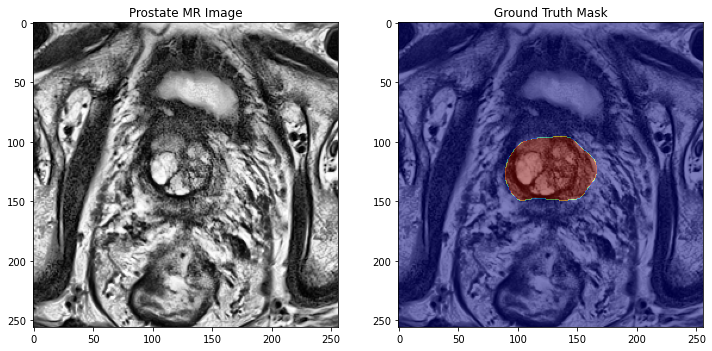

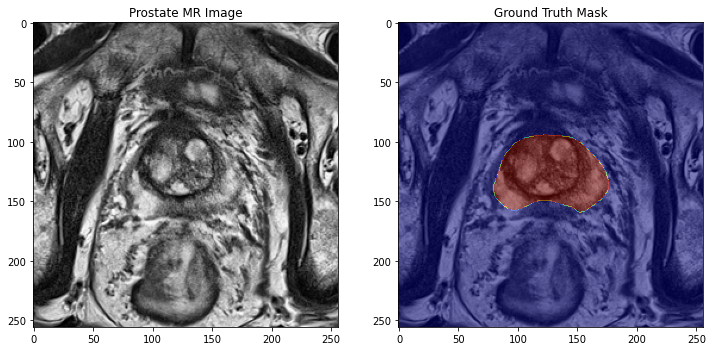

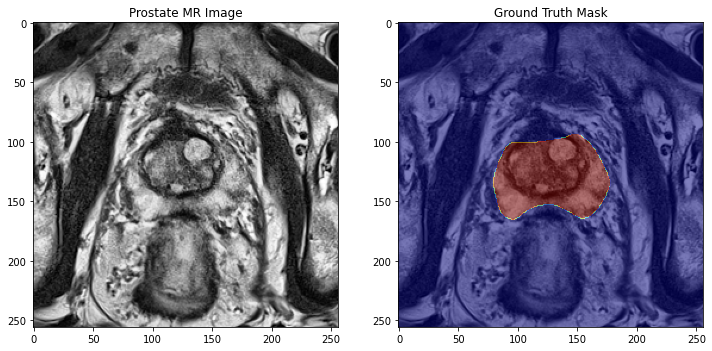

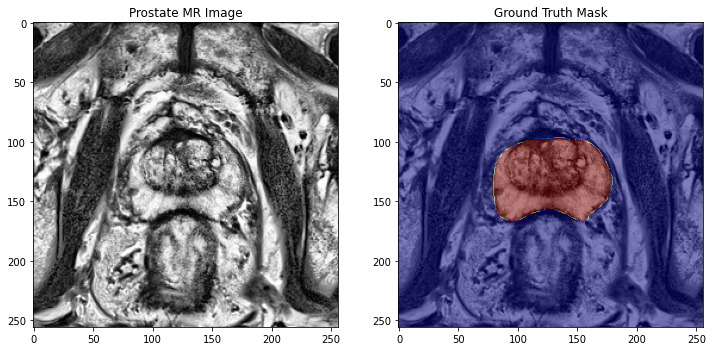

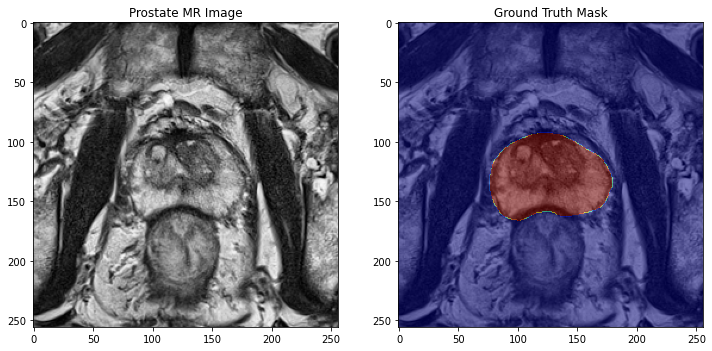

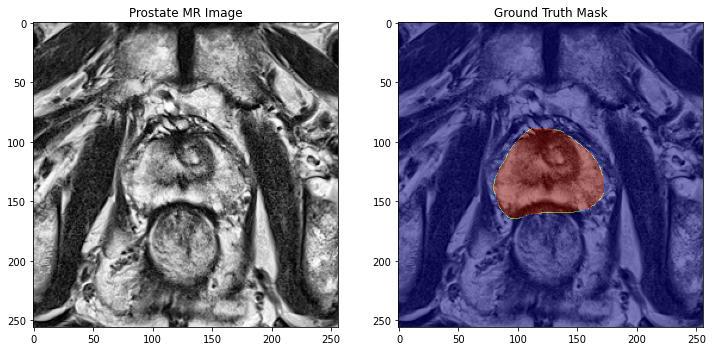

In [154]:
# CSV file contain all the mri slices names - training
ids_train = ImageProcessor.split_data("../input/trainA.csv") 
# CSV file contain all the mri slices names - validation
ids_valid = ImageProcessor.split_data("../input/validA1.csv") 

bs = 16 #Batch size
num_samples = 1000 #number of images to generate.

trainA_generator = DataGenerator(df=ids_valid,
                                 channel="channel_first",
                                 apply_noise=False,
                                 phase="valid",
                                 apply_online_aug=False,
                                 batch_size=bs,
                                 n_samples=-1)
img, mask = trainA_generator.__next__()

print("Intensity mean, std and shapes:", np.min(img), np.max(img), img.shape, mask.shape)

temp = np.argmax(mask, axis=1)
temp2 = np.moveaxis(img, source=1, destination=3)

for i in range(6,12):
    f = plt.figure(figsize=(12,8))
    f.add_subplot(1, 2, 1)
    plt.imshow(temp2[i], cmap='gray'),
    plt.title('Prostate MR Image')
    f.add_subplot(1, 2, 2)
    plt.imshow(temp2[i], cmap='gray'),
    plt.imshow(temp[i], cmap='jet', alpha=0.5);
    plt.title('Ground Truth Mask')
    plt.show(block=True)

---
## 2.2 Hyperparmeters

In [6]:
unetlr = 0.0001       # learning rate
epochs = 100          # number of training epochs
gaussianNoise = True # whether to apply guassian noise for data augmentation or not
batch_size = 16       # Batch size
n_samples = 100       # Number of training samples
n_class = 2           # Softmax output 
n_filter = 16          # UNet initial filter
n_block = 4           # depth of the network
pretrained = False    # whether to load the pretrained network or not

---
## 2.3 Model Training

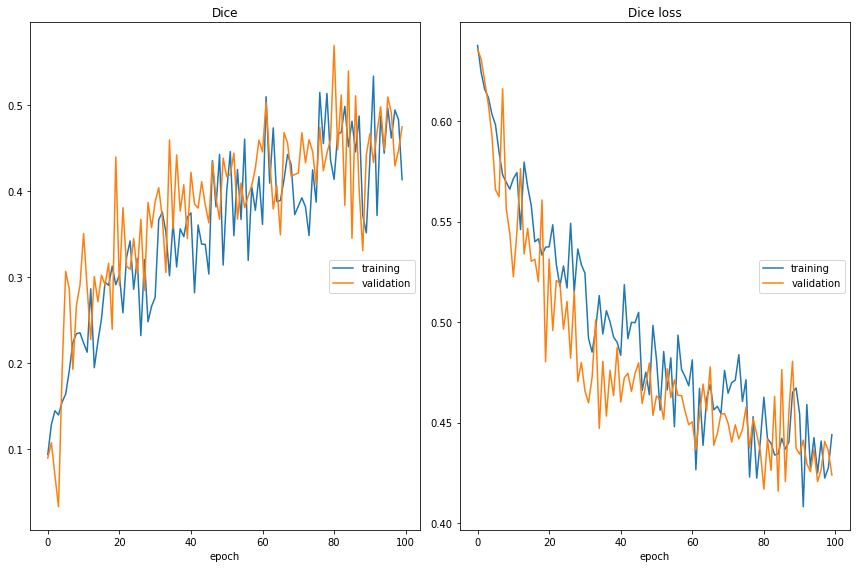

Dice
	training         	 (min:    0.094, max:    0.534, cur:    0.413)
	validation       	 (min:    0.033, max:    0.569, cur:    0.475)
Dice loss
	training         	 (min:    0.408, max:    0.638, cur:    0.444)
	validation       	 (min:    0.416, max:    0.636, cur:    0.424)
Best model on epoch 80: train_dice 0.41368328554943473, valid_dice 0.569409824980581
write a training summary
Finish training
time elapsed for training (hh:mm:ss.ms) 0:56:02.526095


In [98]:
"""
@Author: Sulaiman Vesal
Date: Tuesday, 02, 2021

"""
class Trainer:
    def __init__(self, train_path="../input/trainA.csv",
                 test_path="../input/validA.csv",
                 width=256,
                 height=256,  #image size
                 batch_size=16,
                 n_epoch=50,
                 unet_model=None,
                 unet_loss=DiceCoefMultilabelLoss(),
                 unet_lr=0.001,
                 apply_scheduler=True,  # learning rates
                 gaussian_noise=False,
                 transform=False,
                 r_bright=False,
                 r_gamma=False,
                 n_samples=2000,
                 unet_model_name='unet_model_checkpoint.pt',
                 summary_name='./summary/',
                 channel='channel_first'):

        assert channel == 'channel_first' or channel == 'channel_last', r"channel has to be 'channel_first' or ''channel_last"
        self.train_path, self.test_path = train_path, test_path
        self.WIDTH, self.HEIGHT = width, height
        self.BATCH_SIZE = batch_size
        self.noise = gaussian_noise
        self.epochs = n_epoch
        self.n_samples = n_samples
        self.unet_model_name = unet_model_name
        self.to_save_entire_model = False # with model structure
        self.file_to_save_summary = summary_name
        self.channel = channel
        self._apply_transform = transform
        self._r_bright = r_bright
        self._r_gamma = r_gamma
        self.unet_model = unet_model
        self.unet_loss = unet_loss
        self.unet_lr = unet_lr
        self.apply_scheduler = apply_scheduler
        self.unet_optim  = t.optim.Adam(self.unet_model.parameters(), lr=unet_lr, betas=(0.9, 0.99))


    def get_generators(self, ids_train, ids_valid):
        trainA_generator = DataGenerator(df=ids_train,
                                         channel="channel_first",
                                         apply_noise=True,
                                         phase="train",
                                         apply_online_aug=False,
                                         batch_size=self.BATCH_SIZE,
                                         n_samples=self.n_samples)
        validA_generator = DataGenerator(df=ids_valid,
                                         channel="channel_first",
                                         apply_noise=False,
                                         phase="valid",
                                         apply_online_aug=False,
                                         batch_size=self.BATCH_SIZE,
                                         n_samples=-1)
        return iter(trainA_generator), iter(validA_generator)

    def tocude(self):
        self.unet_model.cuda()
        self.unet_loss.cuda()

    def togglephase(self, phase="train"):
        assert phase == "train" or phase == "eval"
        if phase == "train":
            self.unet_model.train()
        else:
            self.unet_model.eval()

    def zerograd(self):
        self.unet_optim.zero_grad()

    def togglegrads(self, model="unet", require_grads=True):
        assert model == "unet"
        if model == "unet":
            for param in self.unet_model.parameters():
                param.requires_grad = require_grads

    def step(self):
        self.unet_optim.step()
        
        
    def valid_model(self, data_generator, hd=False):
        self.unet_model.eval()
        dice_list = []
        loss_list = []
        hd_list = []
        with t.no_grad():
            for dataset in data_generator:
                x_batch, y_batch = dataset
                prediction = self.unet_model.forward(t.tensor(x_batch).cpu(), features_out=False)
                l = self.unet_loss.forward(predict=prediction, target=t.tensor(y_batch).cpu(), channel='channel_first')
                loss_list.append(l.item())
                y_pred = soft_to_hard_pred(prediction.cpu().detach().numpy(), 1)
                dice_list.append(dice_coef_multilabel(y_true=y_batch, y_pred=y_pred, channel='channel_first'))
        output = {}
        output["dice"] = np.mean(np.array(dice_list))
        output["loss"] = np.mean(np.array(loss_list))
        if hd:
            output["hd"] = np.mean(np.array(hd_list))
        return output

    def train_epoch(self, trainA_generator):

        unet_loss = []
        unet_dice = []

        self.togglephase(phase="train")
        # train unet
        for dataA in trainA_generator:
            self.zerograd()
            imgA, maskA = dataA

            # train the unet model
            self.togglegrads(model="unet", require_grads=True)

            l = t.tensor([0], dtype=t.float32).cpu()
            # forward the image into model
            segmentation, btnck = self.unet_model.forward(t.tensor(imgA).cpu(), features_out=True)
            
            # forward the prediction model to the loss function
            l_segmentation = self.unet_loss.forward(predict=segmentation,
                                             target=t.tensor(maskA).cpu(),
                                             channel=self.channel)
            l += l_segmentation
            
            # backpropagate the loss
            if l != t.tensor([0], dtype=t.float32).cpu():
                l.backward()
            
            # update the optimizer
            self.step()
            # convert the soft probablities to hard probablities for metric computation
            y_pred = soft_to_hard_pred(segmentation.cpu().detach().numpy(), 1)
            unet_loss.append(l_segmentation.item())
            
            # compute the dice metric for training data.
            unet_dice.append(dice_coef_multilabel(y_true=maskA, y_pred=y_pred, channel=self.channel))

        output = {}
        output["unet_loss"] = np.mean(np.array(unet_loss))
        output["unet_dice"] = np.mean(np.array(unet_dice))
        return output

    def train_model(self, train=True, comments=''):

        # create directory for the weights
        root_directory = '../weights/' + comments + '/'
        if not os.path.exists(root_directory):
            os.mkdir(root_directory)

        # Split the train data into train and validation using image names
        ids_train = ImageProcessor.split_data(self.train_path)
        ids_valid = ImageProcessor.split_data(self.test_path)
        print("Trainining on {} images and validating on {} images...!!".format(len(ids_train), len(ids_valid)))

        trainA_iterator, validA_iterator = self.get_generators(ids_train, ids_valid)
        # convert models and losses to cuda
        #self.tocude()

        if self.apply_scheduler:
            unet_scheduler = ReduceLROnPlateau(optimizer=self.unet_optim,
                                               mode='max',
                                               factor=.1,
                                               patience=100,
                                               verbose=True)

        earlystop = EarlyStoppingCallback(patience=10, mode="max")
        modelcheckpoint_unet = ModelCheckPointCallback(mode="max",
                                                       model_name=root_directory + self.unet_model_name,
                                                       entire_model=self.to_save_entire_model)

        train_loss = []
        train_dice = []
        val_loss = []
        val_dice = []
        
        liveloss = PlotLosses()
        for epoch in range(self.epochs):
            ###################
            # train the model #
            ###################
            logs = {}
            if train:
                print("start to train")
                output = self.train_epoch(trainA_iterator)
                train_loss.append(output["unet_loss"])
                train_dice.append(output["unet_dice"])
                
                logs['' + 'Dice loss'] = output["unet_loss"]
                logs['' + 'Dice'] = output["unet_dice"]

                # reduceLROnPlateau
                if self.apply_scheduler:
                    unet_scheduler.step(metrics=train_dice[-1])

            ######################
            # validate and test the model #
            ######################
            self.togglephase(phase="eval")

            print("start to valid")
            output = self.valid_model(data_generator=validA_iterator, hd=False)
            val_dice.append(output["dice"])
            val_loss.append(output["loss"])
            
            logs['val_' + 'Dice loss'] = output["loss"]
            logs['val_' + 'Dice'] = output["dice"]
            
            epoch_len = len(str(self.epochs))
            
            print_msg_line1 = f'valid_loss: {val_loss[-1]:.5f} '
            print_msg_line2 = f'valid_dice: {val_dice[-1]:.5f} '
            if train:
                print_msg_line1 = f'train_loss: {train_loss[-1]:.5f} ' + print_msg_line1
                print_msg_line2 = f'train_dice: {train_dice[-1]:.5f} ' + print_msg_line2
            print_msg_line1 = f'[{epoch + 1:>{epoch_len}}/{self.epochs:>{epoch_len}}] ' + print_msg_line1
            print_msg_line2 = ' ' * (2 * epoch_len + 4) + print_msg_line2
            print(print_msg_line1)
            print(print_msg_line2)

            # model chekc point
            monitor_score = val_dice[-1]
            modelcheckpoint_unet.step(monitor=monitor_score, model=self.unet_model, epoch=epoch)

            # early stop
            earlystop.step(val_dice[-1])
            if earlystop.should_stop():
                break
                
            liveloss.update(logs)
            liveloss.send()
            
        the_epoch = modelcheckpoint_unet.epoch
        print("Best model on epoch {}: train_dice {}, valid_dice {}".format(the_epoch,
                                                                            train_dice[the_epoch],
                                                                            val_dice[the_epoch]))
        # record train metrics in tensorboard
        writer = SummaryWriter(comment=comments)
        # writer = SummaryWriter()
        i = 0
        print("write a training summary")
        for t_loss, t_dice, v_loss, v_dice in zip(
                train_loss, train_dice, val_loss, val_dice):
            writer.add_scalar('Loss/Training', t_loss, i)
            writer.add_scalar('Loss/Validation', v_loss, i)
            writer.add_scalar('Dice/Training', t_dice, i)
            writer.add_scalar('Dice/Validation', v_dice, i)
            i += 1
        writer.close()
        print("Finish training")

if __name__ == '__main__':

    config_info = "filters {}, n_block {}".format(n_filter, n_block)
    print(config_info)

    # calculate the comments
    comments = "porstate_MRI.unet_lr_{}_{}".format(unetlr, n_filter)
    if gaussianNoise:
        comments += ".gaussian_noise"
    print(comments)

    unet_model = Segmentation_model(filters=n_filter,
                                    in_channels=1,
                                    n_block=n_block,
                                    bottleneck_depth=4,
                                    n_class=n_class)

    if pretrained:
        unet_model.load_state_dict(torch.load('../weights/{}/unet_model_checkpoint.pt'.format(comments)))

    train_obj = Trainer(width= 256,
                        height=256,
                        batch_size=batch_size,  # 8
                        unet_model=unet_model,
                        unet_loss=DiceCoefMultilabelLoss(),
                        gaussian_noise=gaussianNoise,
                        unet_lr=unetlr,
                        n_epoch=epochs,
                        n_samples=n_samples)

    # train the models
    print("number of samples {}".format(n_samples))
    start = datetime.now()
    t.autograd.set_detect_anomaly(True)
    train_obj.train_model(comments=comments)
    end = datetime.now()
    print("time elapsed for training (hh:mm:ss.ms) {}".format(end - start))


---
## 2.4 Model Training Plot

Due to lack of GPU on my machine, I transferred the code and data into our lab GPU clusters and ran it for 100 epochs for faster training process. Below, you can see the training and validation plot of the model for Prostate-MRI data.

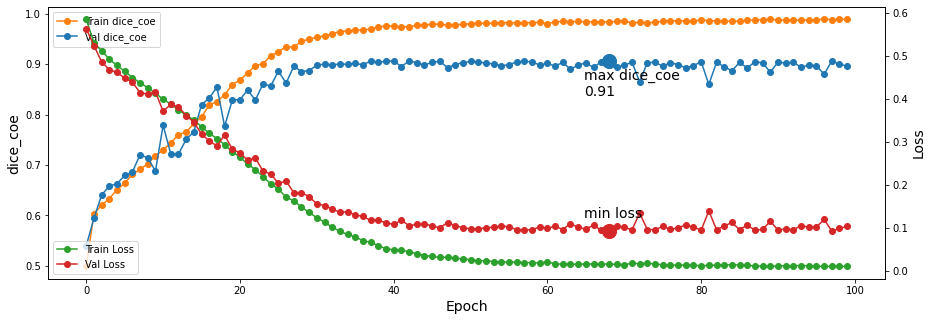

In [135]:
plot_history("../../Stanford_coding_challenge/input2/history.csv")

---
# 3. Model Inference

So now that we have the trained model. We can test the model even using CPU on the local machine. I just transferred the weights to the local folder on my pc and evaluate the performance of the trained model on unseen data. 

In [147]:
"""
@Author: Sulaiman Vesal
Date: Tuesday, 04, 2021

"""

import matplotlib.animation as animation
from matplotlib.animation import PillowWriter

# Best model on epoch 68: train_dice 0.9838243208306661, valid_dice 0.9067579401632643
# write a training summary
# Finish training
# time elapsed for training (hh:mm:ss.ms) 2:55:17.950923
        
def predict_single_volume(img_path, mask_path, unet_model, header, plot=False, filename=None):
    
    # unet_model.eval()
    # Read the dicom images from test folder with ground-truth for model evaluation
    img, mask, opts, outshape = get_test_dataset(img_path, 
                                                 mask_path, 
                                                 npy= False,
                                                 crop=True, 
                                                 crop_size = 128)
    # Merge lables to have a binary ground-truth [0, 1, 2] -> [0,1]
    mask = np.where(mask>0, 1, 0)
    if filename=="Prostate3T":
        mask = mask[::-1,:,:]
    # Rescale the pixel intensities to [0, 255]
    img = convert(img, 0, 255, np.uint8)
    
    k =0
    for cur_img in img:
        aug = Compose([CLAHE(always_apply=True)])
        augmented = aug(image=cur_img)
        cur_img = augmented["image"]
        img[k, :, :] = cur_img
        k+=1
    
    # min-max batch normalisation
    img = np.array(img, np.float32) / 255.
    img = np.moveaxis(np.expand_dims(img, axis=3), -1, 1)
    
    # predict the volume using trained model
    prediction = unet_model.forward(t.tensor(img).cpu(), features_out=False)
    
    # convert the model prediction to [0, 1]
    y_pred = soft_to_hard_pred(prediction.cpu().detach().numpy(), 1)
    
    # Select the class with highest probablity from softmax output
    y_pred = np.argmax(np.moveaxis(y_pred, 1, -1), axis=-1)
    
    # Apply connected component anlysis to remove outlier segmentation
    y_pred = keep_largest_connected_components(mask=y_pred)
    
    img = np.moveaxis(img, 1, -1)
    
    # Computer the evaluation metrics
    name = compute_metrics_on_files(mask_path, y_pred, mask, opts['space directions'][0], header)
    
    # Plot slice-wise image, ground-truth and model prediction for qualitiatve evaluation
    if plot:
        for im, gt, pred in zip(img, mask, y_pred):
            f = plt.figure(figsize=(16,10))
            f.add_subplot(1, 4, 1)
            plt.imshow(im, cmap='gray'),
            plt.title('Porstate MRI Slice')
            f.add_subplot(1, 4, 2)
            plt.imshow(gt, cmap='jet'),
            plt.title('Ground-Truth')
            f.add_subplot(1, 4, 3)
            plt.imshow(pred, cmap='gray'),
            plt.title('Prediction')
            f.add_subplot(1, 4, 4)
            plt.imshow(overlay_image(im, gt, pred=pred)),
            plt.title('GT-Pred Overlay')
            plt.show(block=True)
        
#         fig = plt.figure()
#         ani = animation.ArtistAnimation(fig, img, interval=50, blit=True, repeat_delay=500)
#         #writer = PillowWriter(fps=20)
#         #ani.save("demo2.gif", writer=writer)
#         plt.show()
    
    y_pred = np.moveaxis(y_pred, 0, 2)
    # Zero pad the prediction to actual input size
    y_pred_padded = pad_volume(y_pred, outshape)
        
    # Rotate and flip annotations to match volumes
    y_pred_padded = rotate_flip_mask(y_pred_padded)
    
    # Save the prediction as nrrd file
    nrrd.write("../results/{}/{}_pred.nrrd".format(filename, name), y_pred_padded, opts)
    

def compute_vol_metrics(unet_model, dataset='valid', mr_type ="PROSTATE-DIAGNOSIS", header = True):
    
    start = datetime.now()
    t.autograd.set_detect_anomaly(True)

    filename = "ProstateDx" if mr_type == "PROSTATE-DIAGNOSIS" else "Prostate3T"
    idx = 2 if dataset == 'valid' else 3

    print("***********************{}-{}: Volumetric Quantification**************************\n".format(dataset,
                                                                                                       filename))
    for i in range(1, 6):
        sample_im = '../../Stanford_coding_challenge/input2/{}/{}/{}-0{}-000{}/'.format(dataset,mr_type,
                                                                                       filename, idx, i)
        sample_mk = '../../Stanford_coding_challenge/input2/{}-segm/{}-0{}-000{}_truth.nrrd'.format(dataset,
                                                                                                   filename,
                                                                                                   idx,i)
        if i==1 and header==True:
            predict_single_volume(sample_im, sample_mk, unet_model, header = True, plot=False, filename=filename)
            header = False
        else:
            predict_single_volume(sample_im, sample_mk, unet_model, header = False, filename=filename)

    end = datetime.now()
    print("time elapsed for testing (hh:mm:ss.ms) {}".format(end - start))

---
## 3.1 Performance Evaluation

In [148]:
config_info = "filters {}, n_block {}".format(n_filter, n_block)
print(config_info)

# calculate the comments
comments = "prostate_MRI.unet_lr_{}_{}".format(unetlr, n_filter)
if gaussianNoise:
    comments += ".gaussian_noise"
print(comments)

unet_model = Segmentation_model(filters=n_filter,
                                in_channels=1,
                                n_block=n_block,
                                bottleneck_depth=4,
                                n_class=n_class)
device = torch.device('cpu')
unet_model.load_state_dict(torch.load('../weights/{}/unet_model_checkpoint.pt'.format(comments), 
                                      map_location=device))


for dataset in ["valid", "test"]:
    for mr_type in ["PROSTATE-DIAGNOSIS", "Prostate-3T"]:
        compute_vol_metrics(unet_model, dataset, mr_type)

print("*******************************************************************************************")

filters 16, n_block 4
prostate_MRI.unet_lr_0.0001_16.gaussian_noise
***********************valid-ProstateDx: Volumetric Quantification**************************

Name                   , Dice [%] ,    HD [mm], Sensitivity [%], Specificity [%],  Vol-Corr ,     P-Value
ProstateDx-02-0001_truth,    0.913,      6.325,      0.879,      0.998,      0.980,       0.000
ProstateDx-02-0002_truth,    0.903,      9.055,      0.894,      0.996,      0.986,       0.000
ProstateDx-02-0003_truth,    0.899,      6.403,      0.873,      0.996,      0.972,       0.000
ProstateDx-02-0004_truth,    0.906,      7.616,      0.905,      0.996,      0.977,       0.000
ProstateDx-02-0005_truth,    0.890,     13.638,      0.953,      0.995,      0.994,       0.000
time elapsed for testing (hh:mm:ss.ms) 0:00:41.329661
***********************valid-Prostate3T: Volumetric Quantification**************************

Name                   , Dice [%] ,    HD [mm], Sensitivity [%], Specificity [%],  Vol-Corr ,     P-Valu

---
# 4. Qualitiative Evaluation

filters 16, n_block 4
prostate_MRI.unet_lr_0.0001_16.gaussian_noise
***********************valid-ProstateDx: Volumetric Quantification**************************

Name                   , Dice [%] ,    HD [mm], Sensitivity [%], Volume (ml), Err Volume(ml)  
ProstateDx-02-0001_truth,    0.909,      6.708,      0.885,     -0.000,     -0.000 


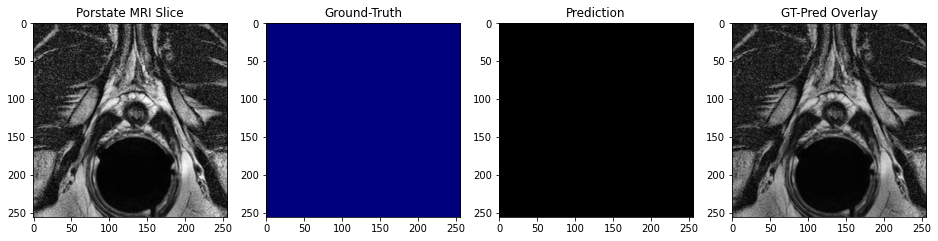

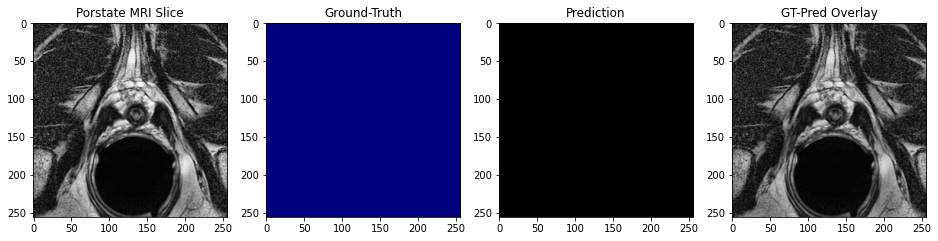

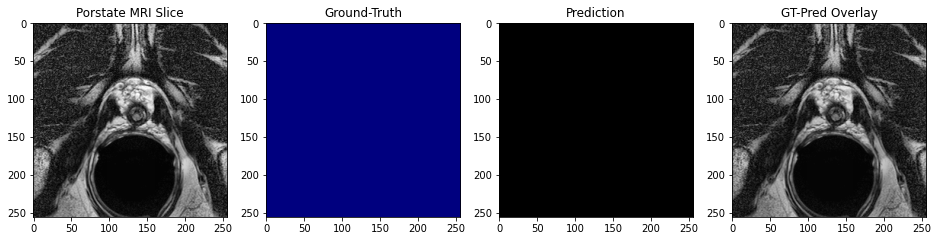

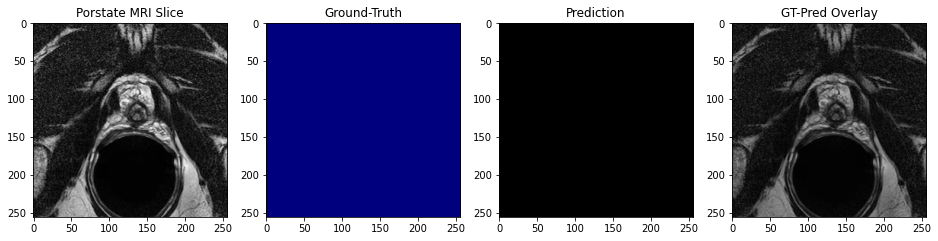

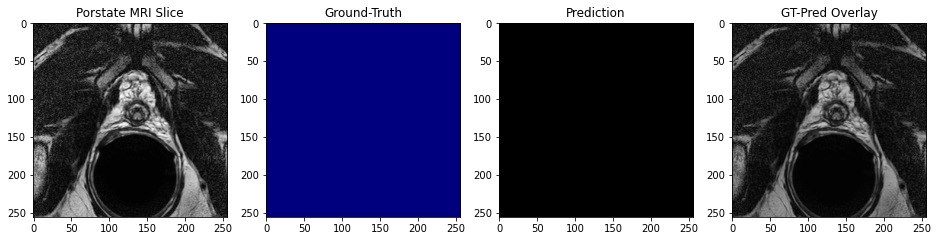

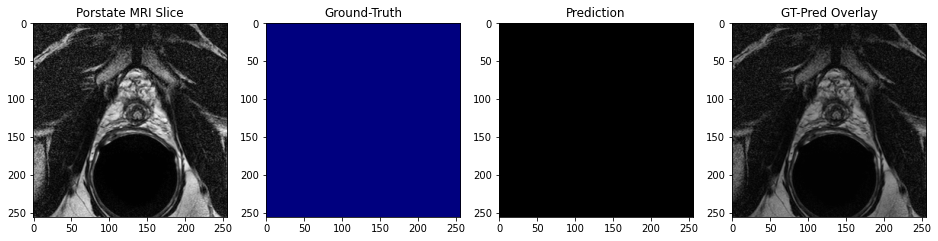

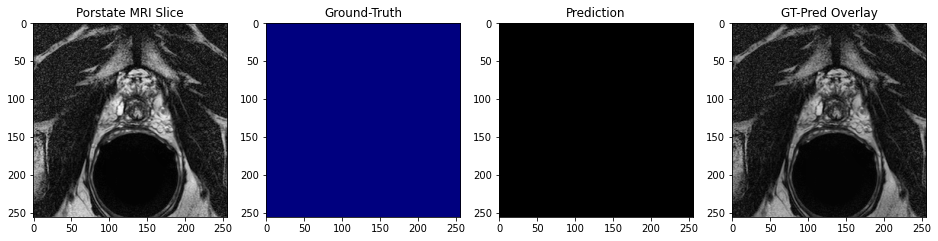

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


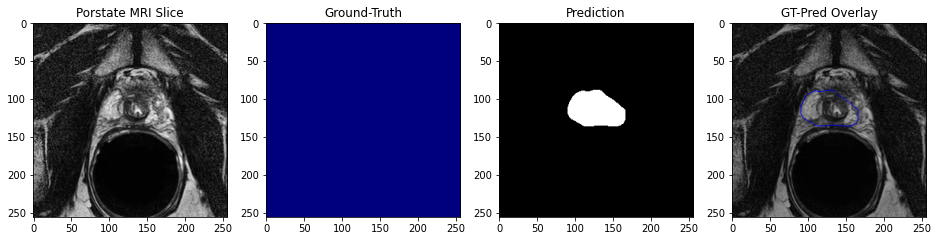

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


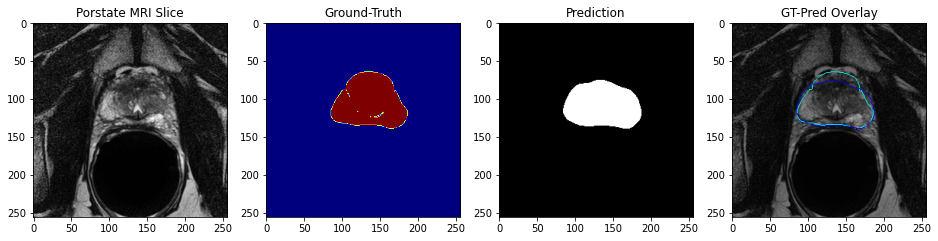

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


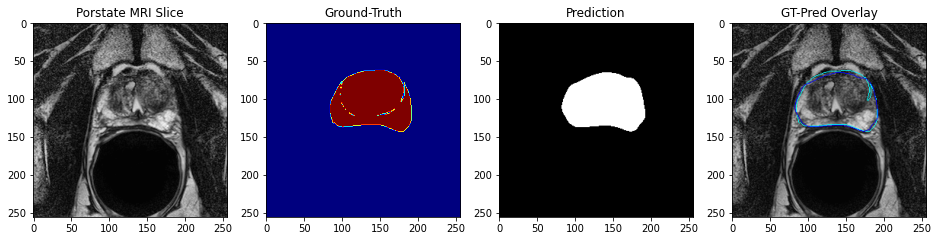

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


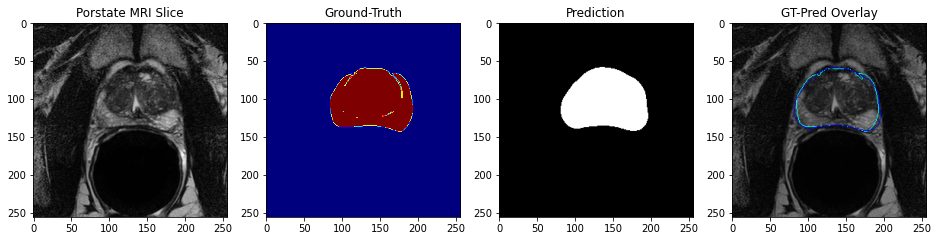

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


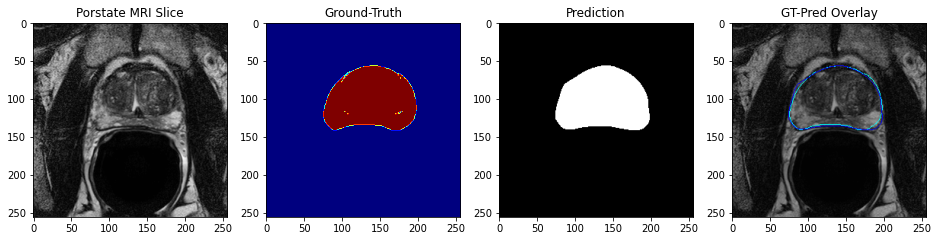

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


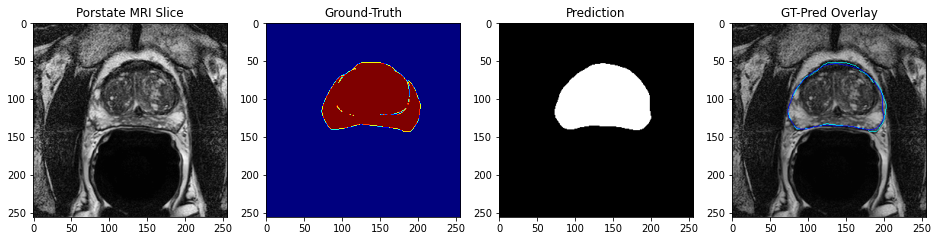

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


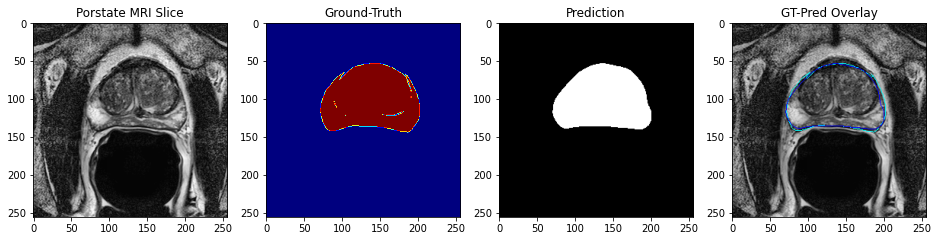

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


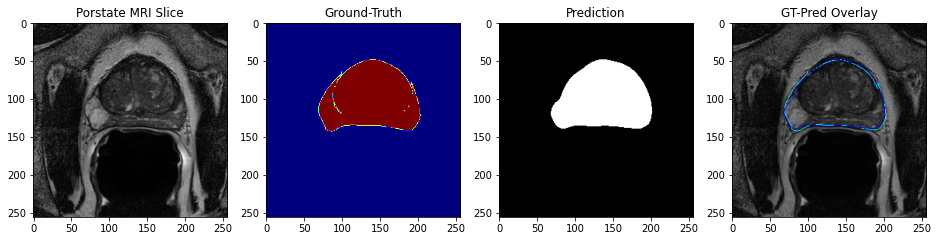

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


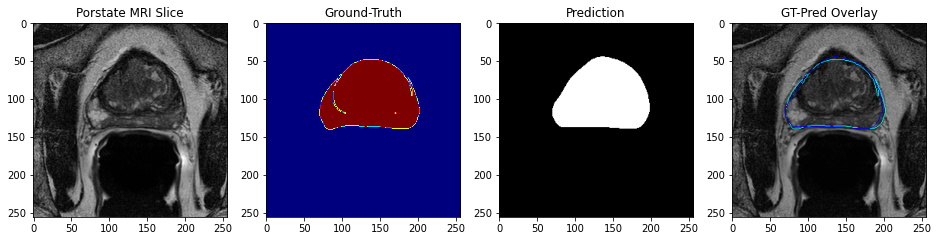

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


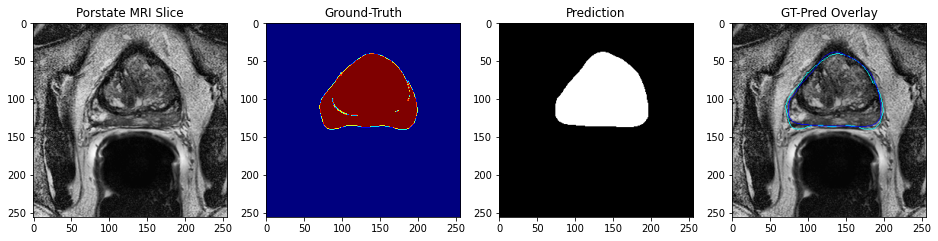

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


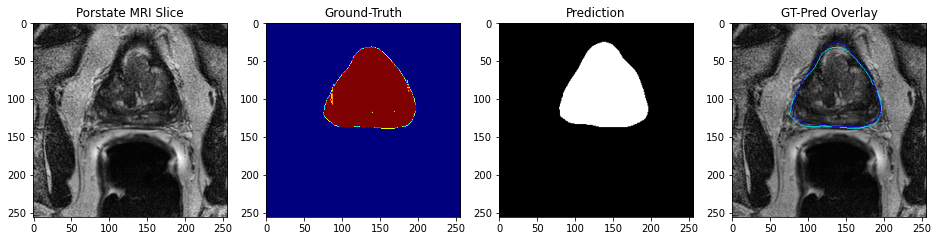

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


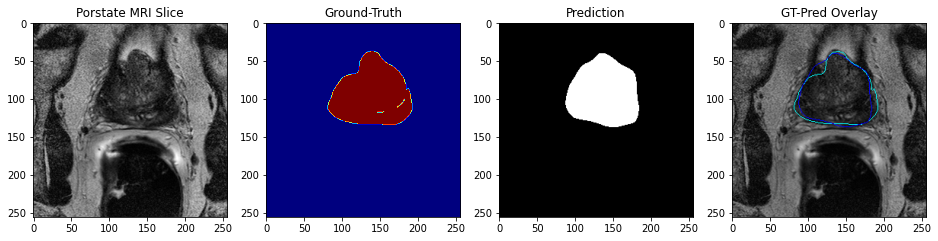

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


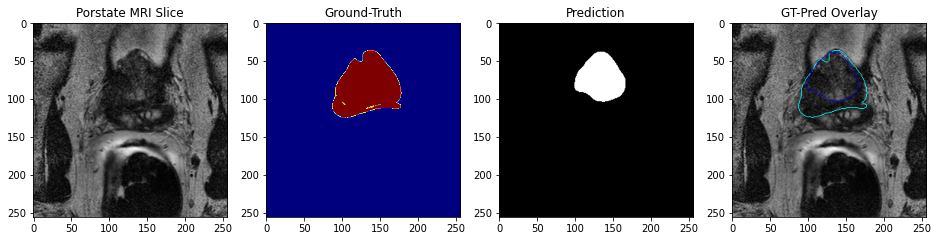

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


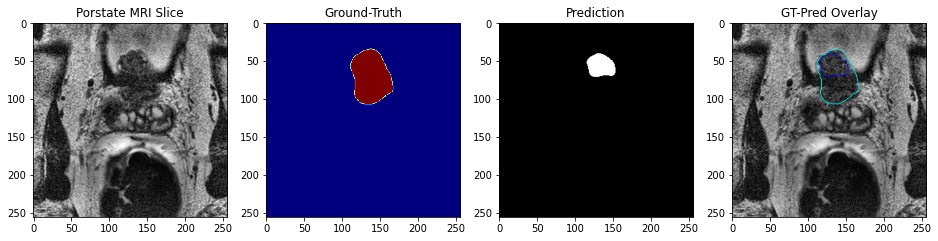

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


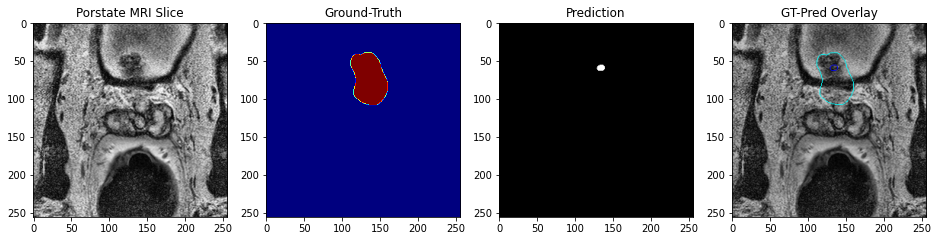

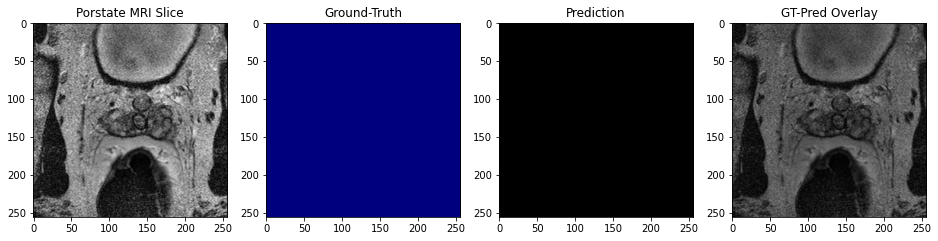

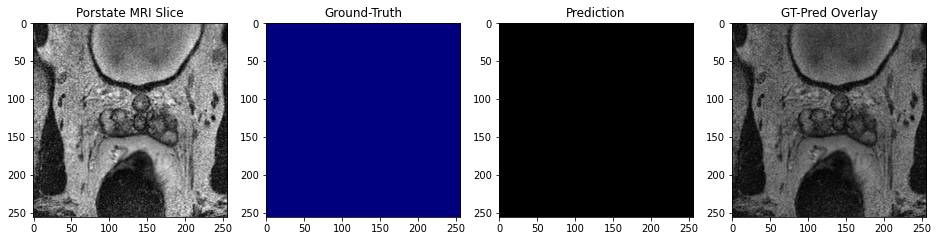

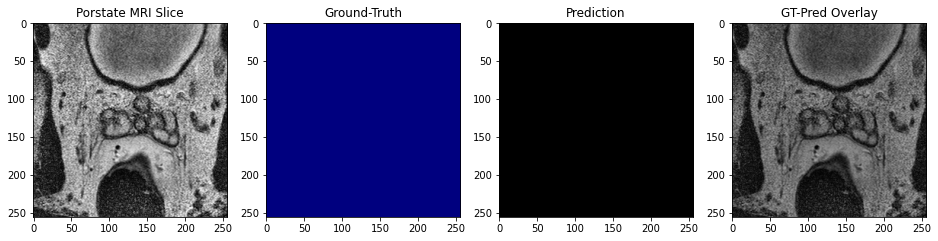

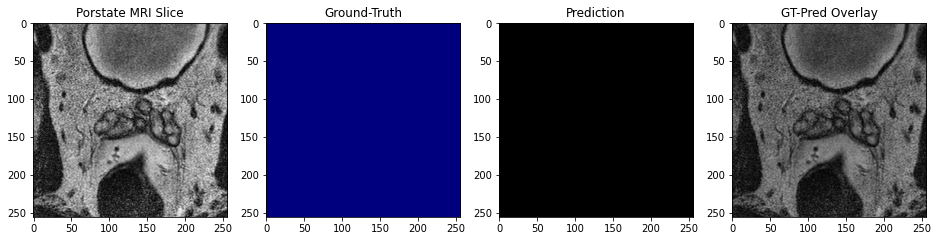

...

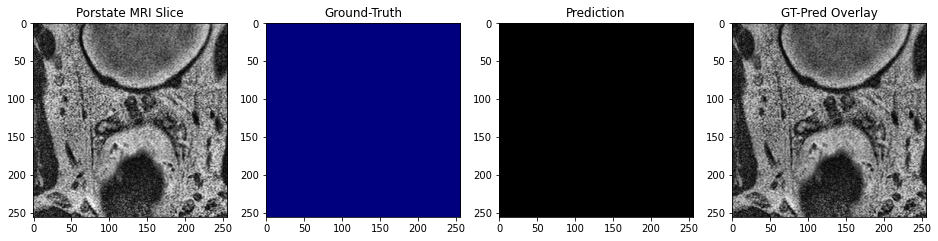

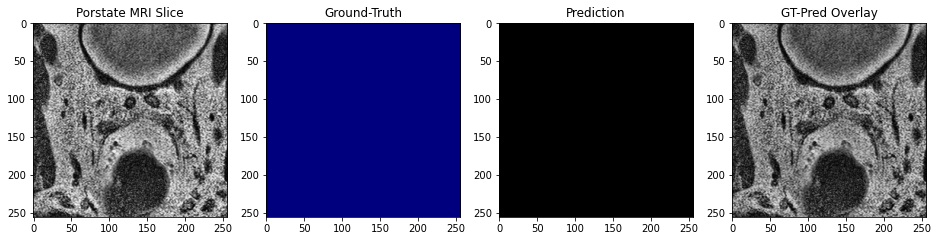

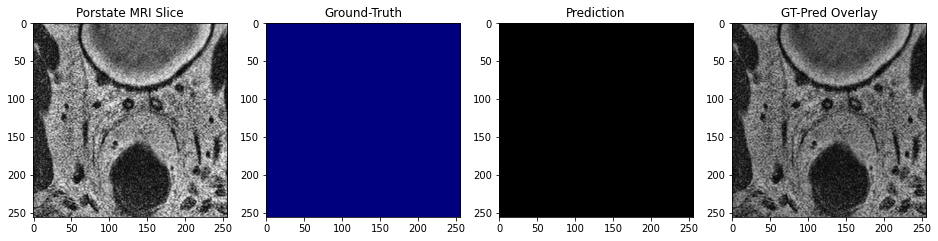

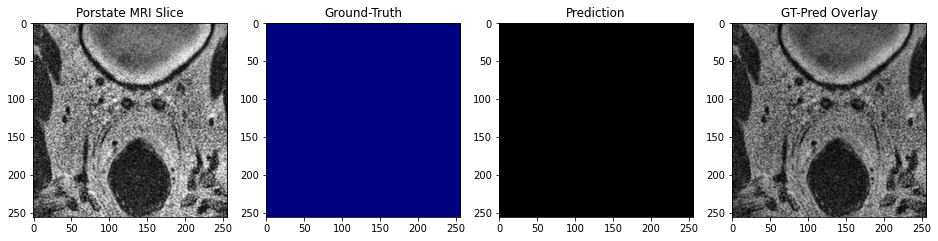

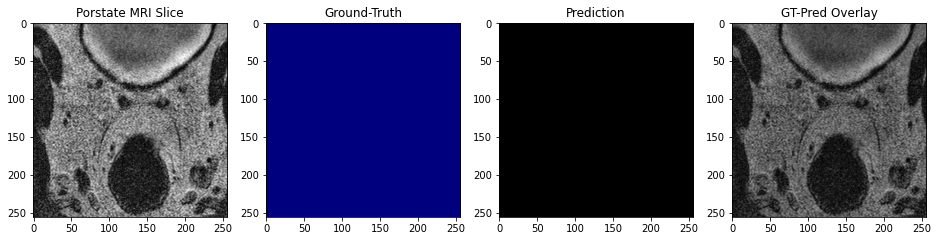

ProstateDx-02-0002_truth,    0.896,     10.050,      0.875,     -0.000,     -0.000 
ProstateDx-02-0003_truth,    0.896,      5.099,      0.872,     -0.020,     -0.001 
ProstateDx-02-0004_truth,    0.906,      9.220,      0.890,     -0.000,     -0.000 
ProstateDx-02-0005_truth,    0.885,     12.570,      0.949,      0.000,      0.000 
time elapsed for testing (hh:mm:ss.ms) 0:00:59.731879
***********************valid-Prostate3T: Volumetric Quantification**************************

Name                   , Dice [%] ,    HD [mm], Sensitivity [%], Volume (ml), Err Volume(ml)  
Prostate3T-02-0001_truth,    0.853,      6.164,      0.901,     -0.008,      0.001 


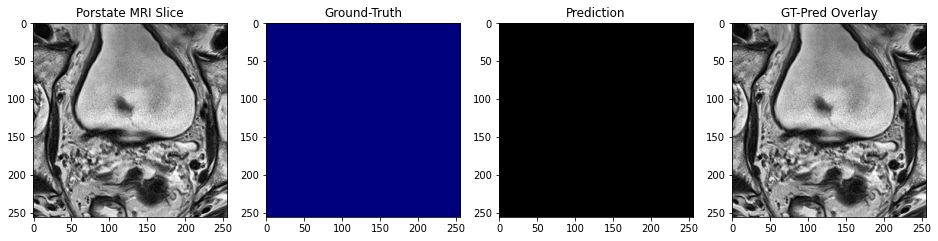

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


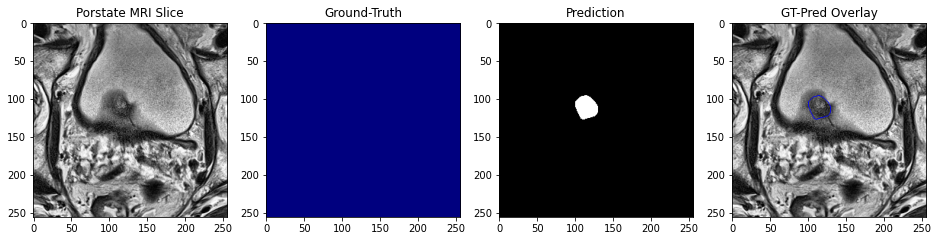

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


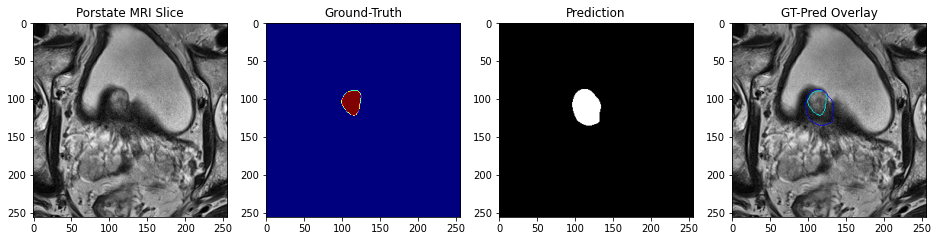

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


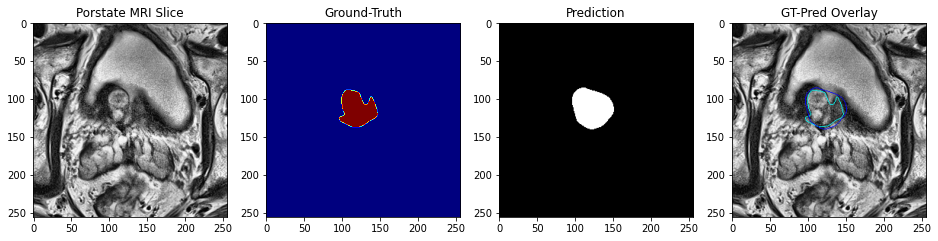

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


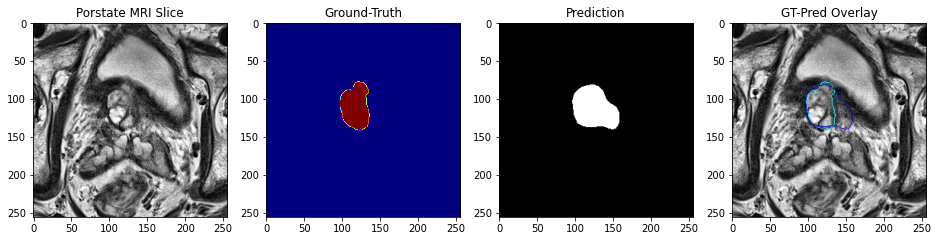

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


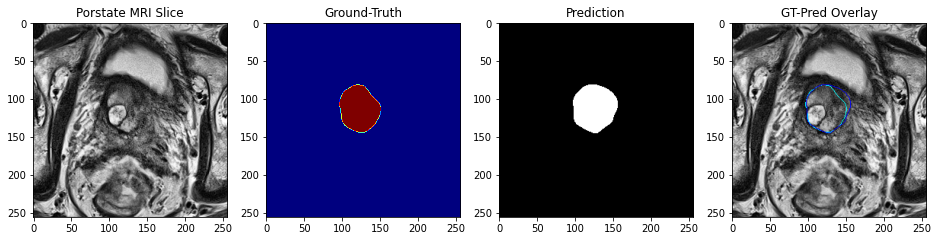

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


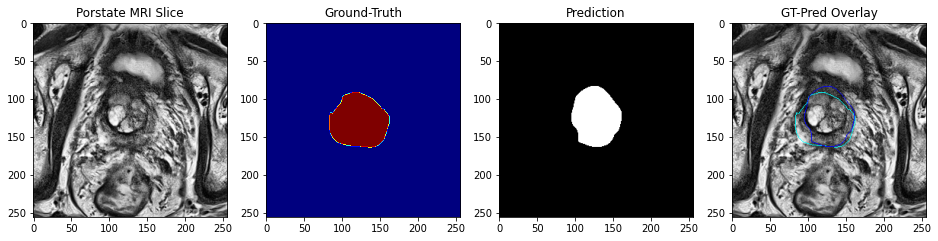

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


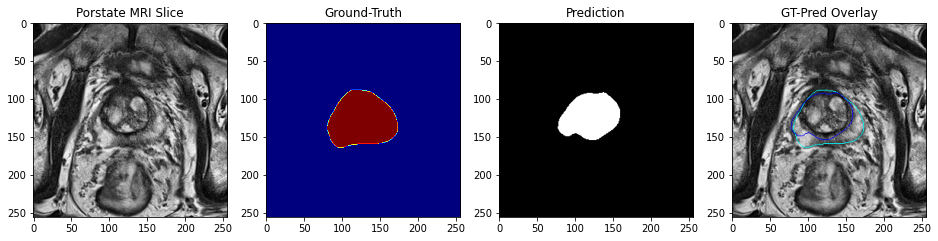

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


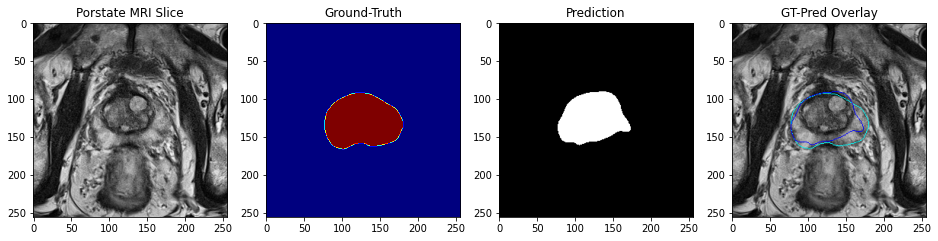

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


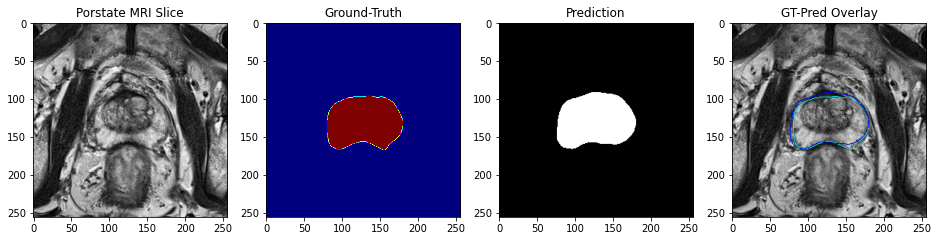

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


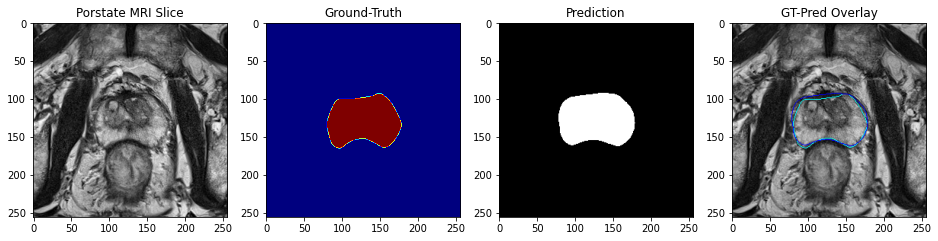

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


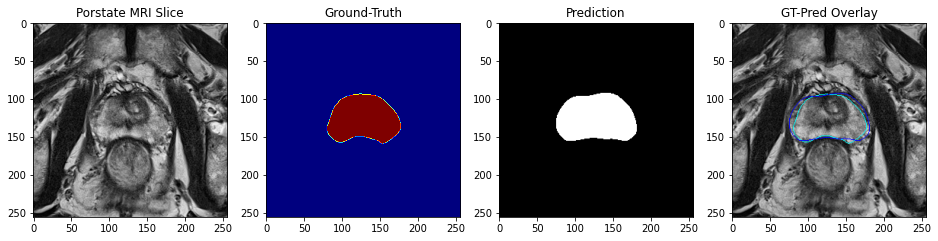

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


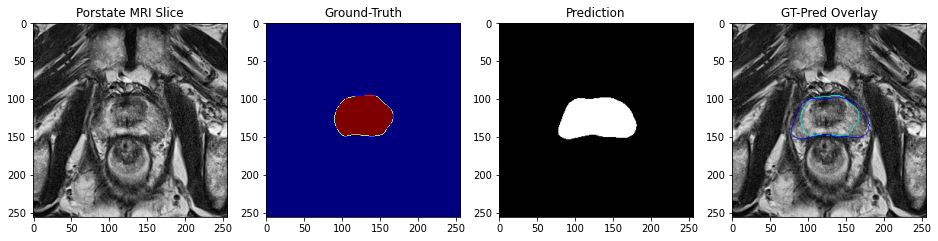

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


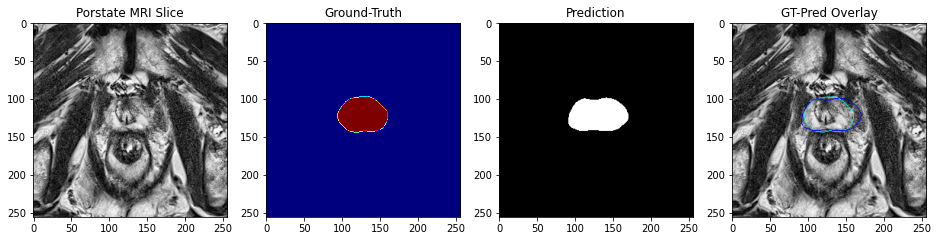

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


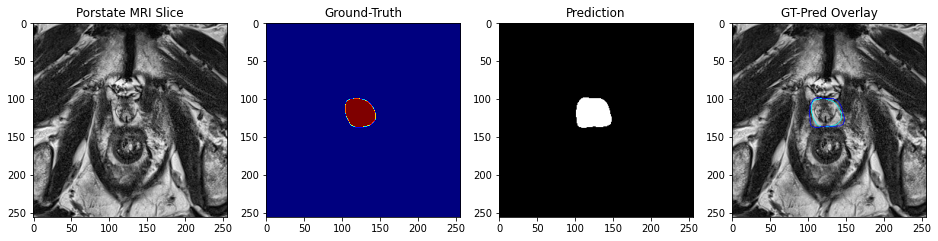

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


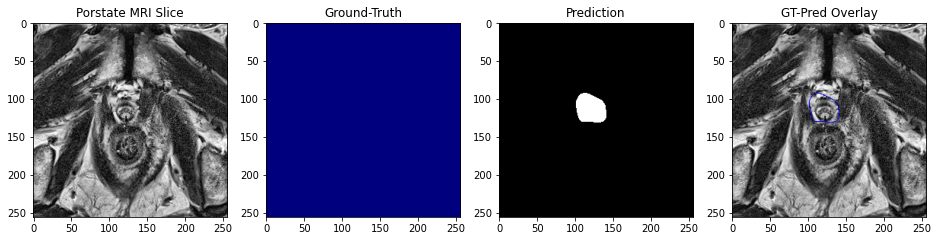

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


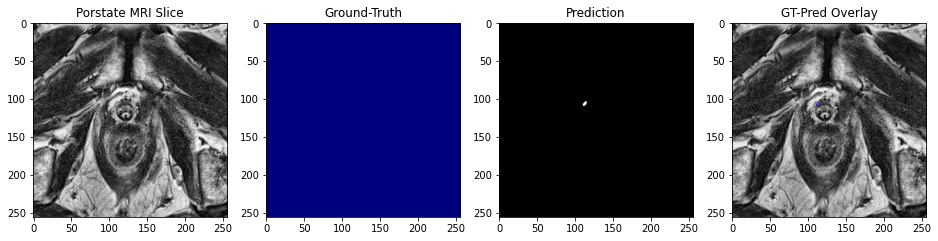

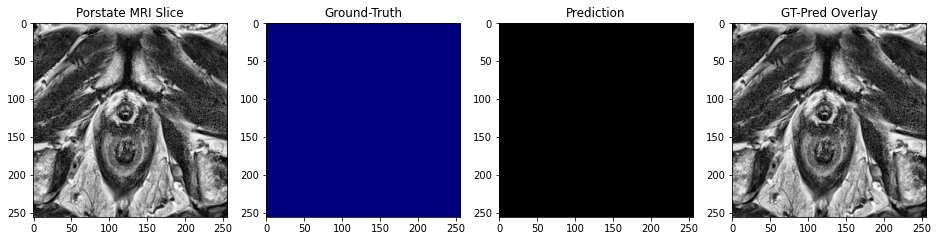

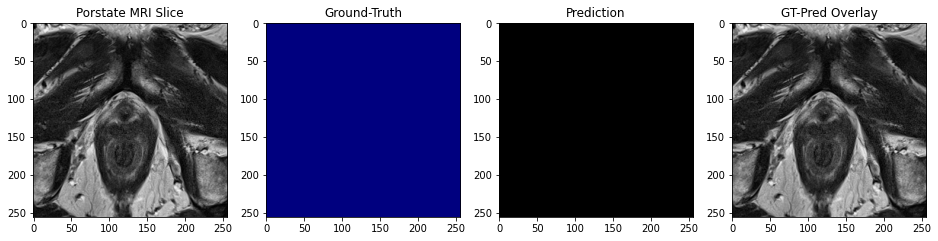

Prostate3T-02-0002_truth,    0.882,      9.644,      0.827,     -0.000,     -0.000 
Prostate3T-02-0003_truth,    0.866,     10.863,      0.866,      0.000,      0.000 
Prostate3T-02-0004_truth,    0.818,     12.728,      0.736,     -0.000,     -0.000 
Prostate3T-02-0005_truth,    0.881,      6.708,      0.833,     -0.000,     -0.000 
time elapsed for testing (hh:mm:ss.ms) 0:00:29.666622
***********************test-ProstateDx: Volumetric Quantification**************************

Name                   , Dice [%] ,    HD [mm], Sensitivity [%], Volume (ml), Err Volume(ml)  
ProstateDx-03-0001_truth,    0.920,     14.353,      0.950,      0.000,      0.000 


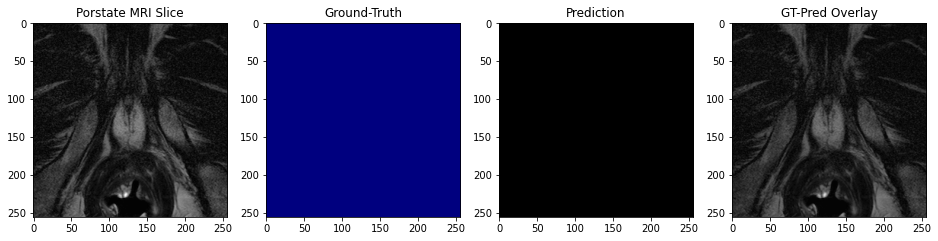

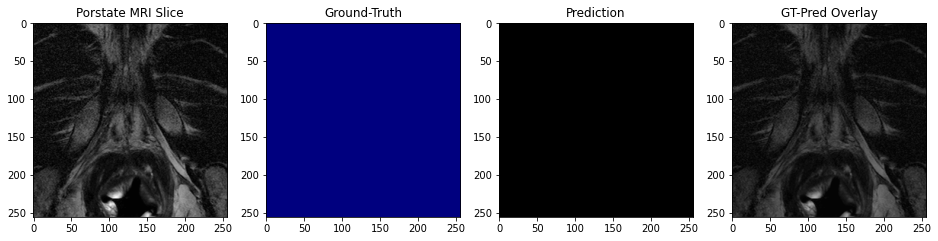

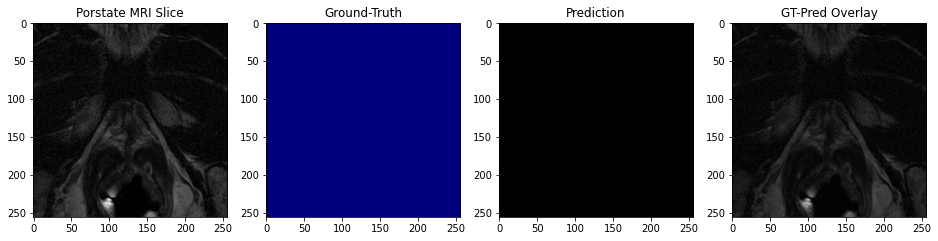

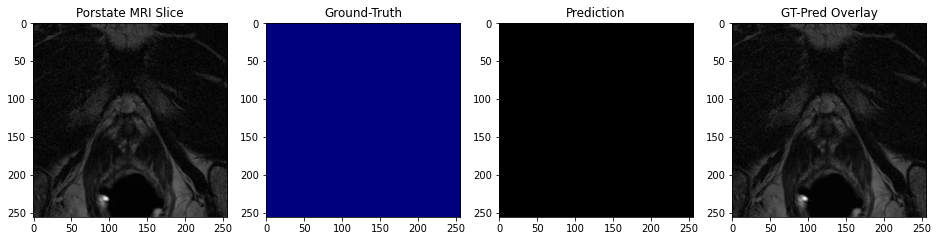

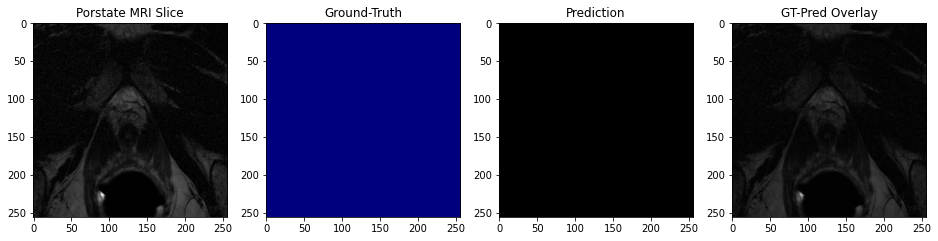

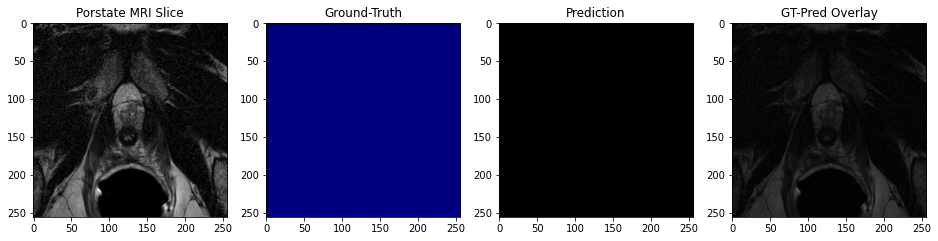

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


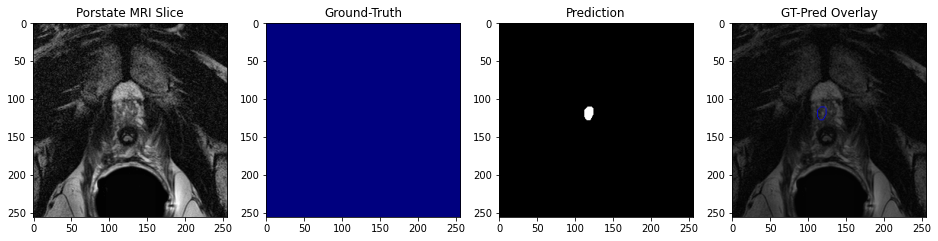

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


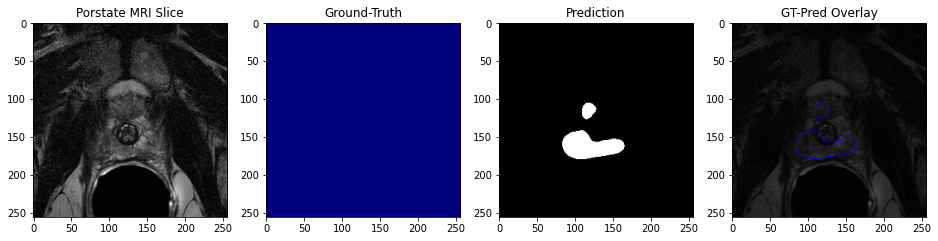

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


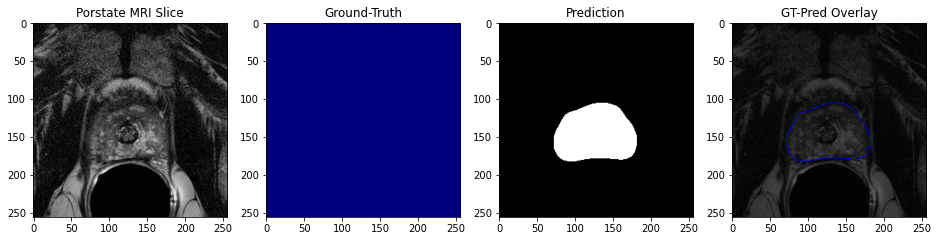

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


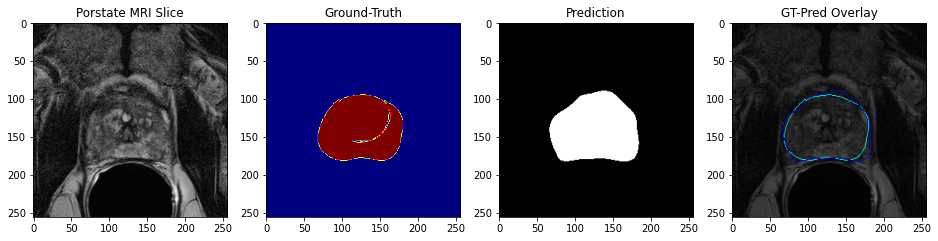

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


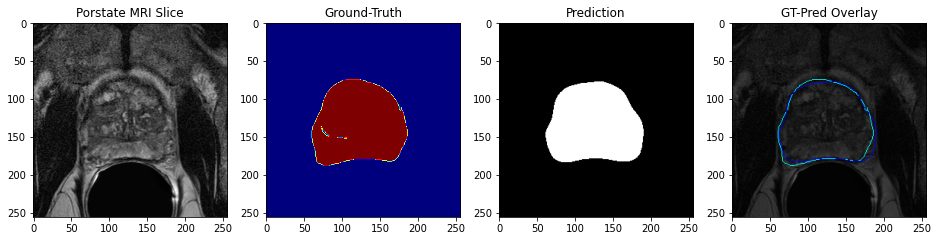

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


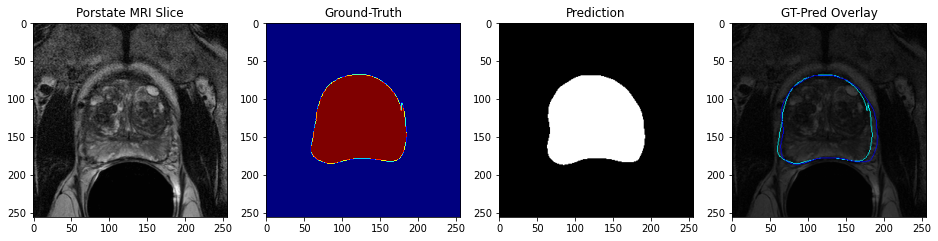

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


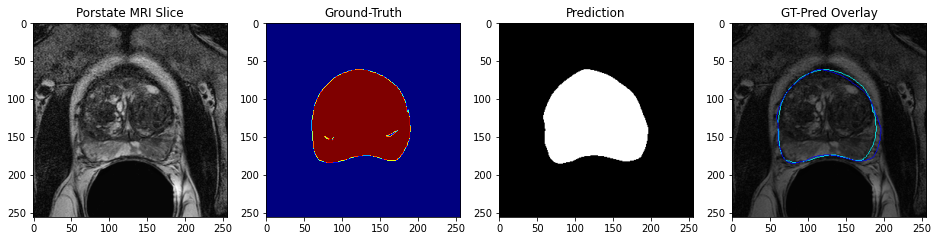

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


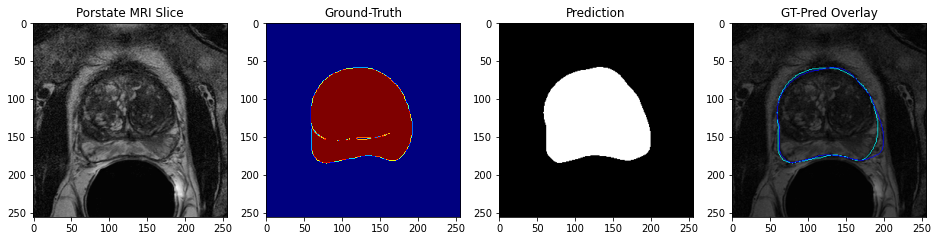

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


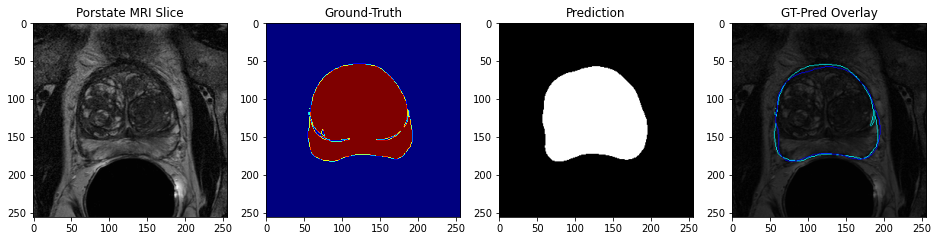

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


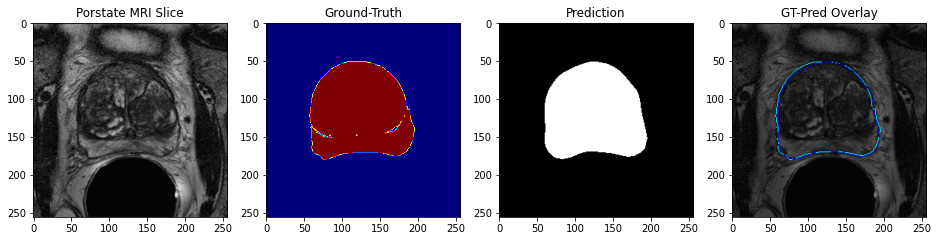

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


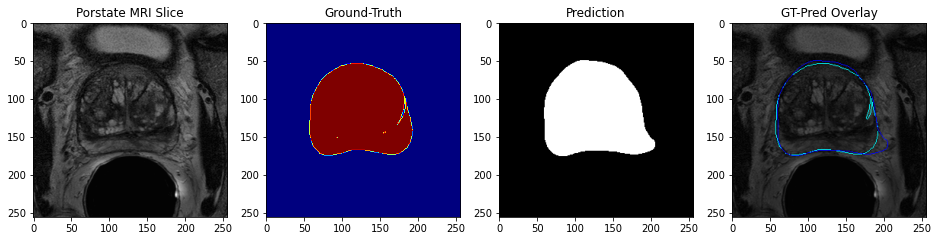

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


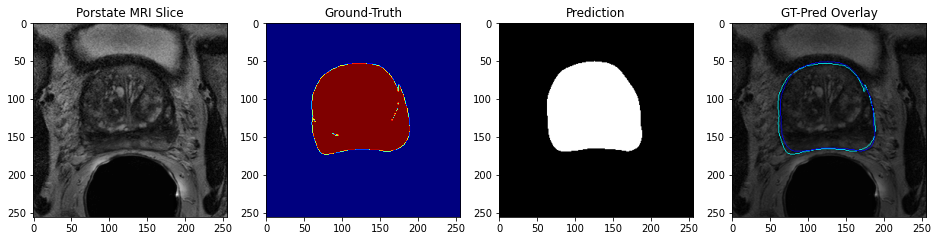

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


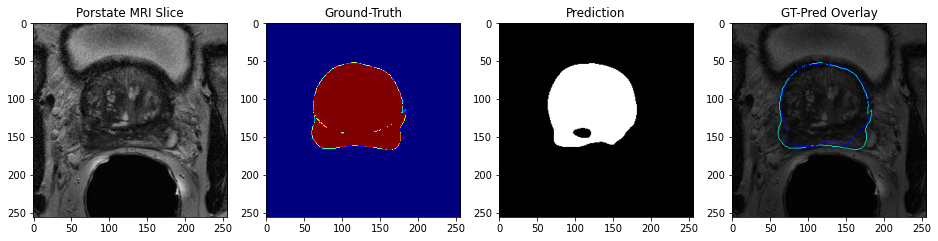

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


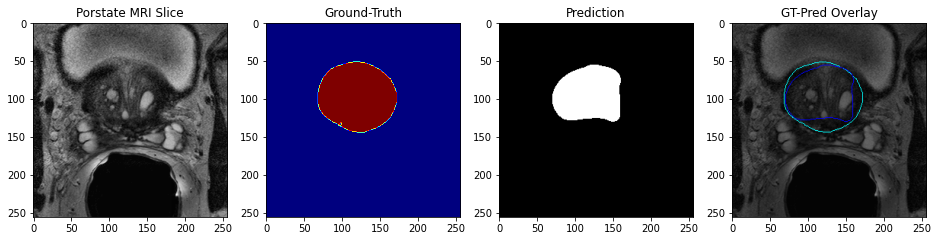

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


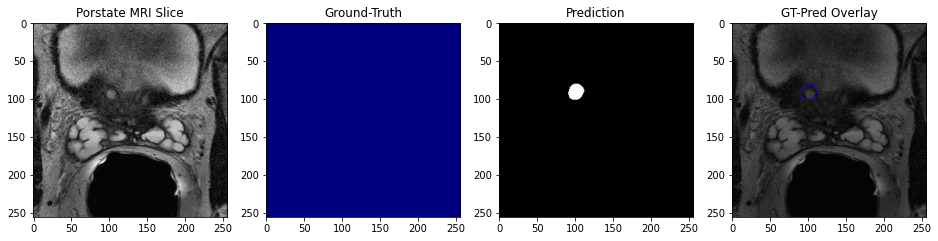

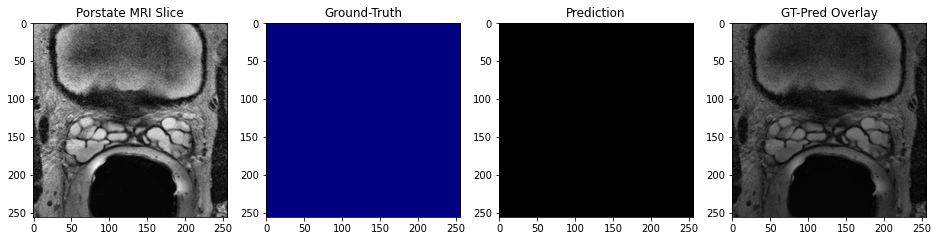

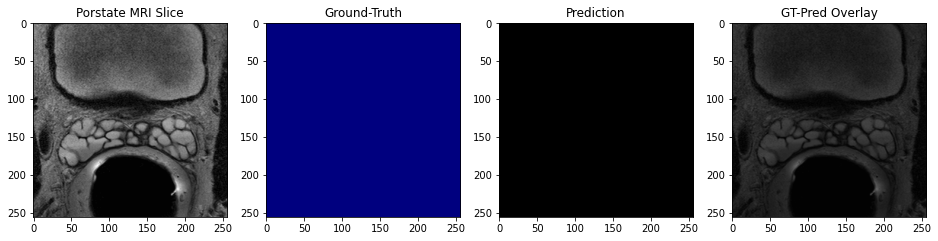

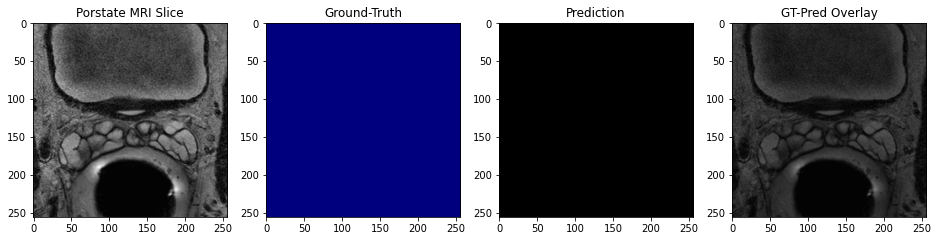

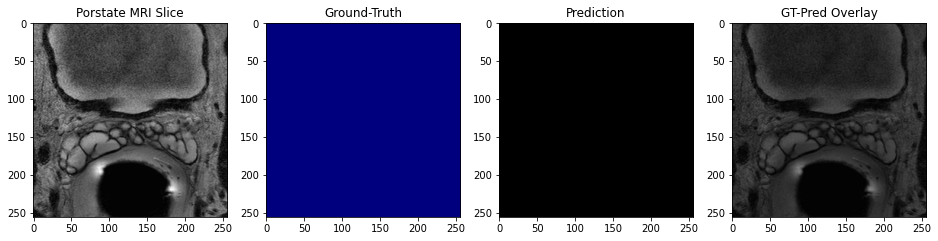

...

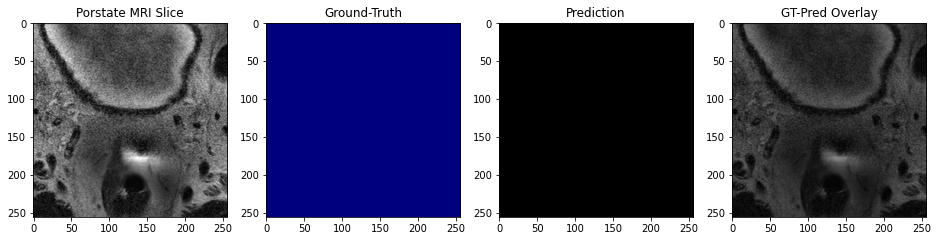

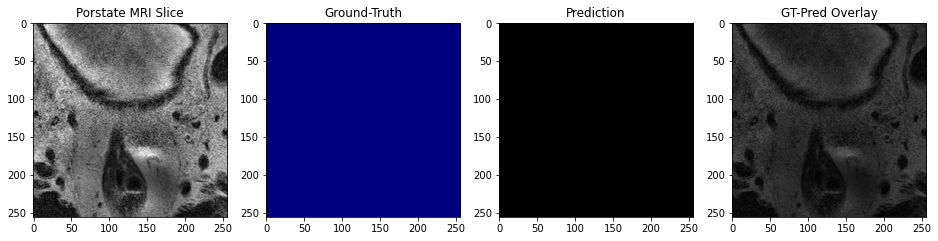

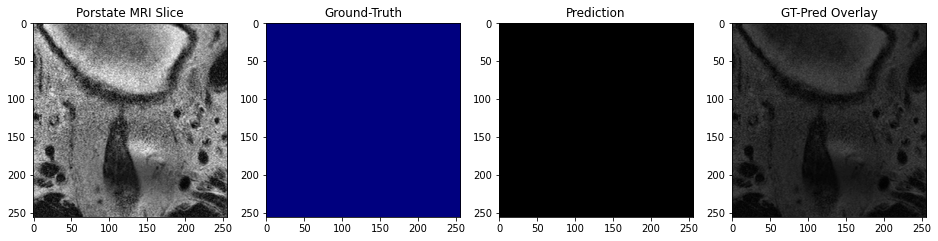

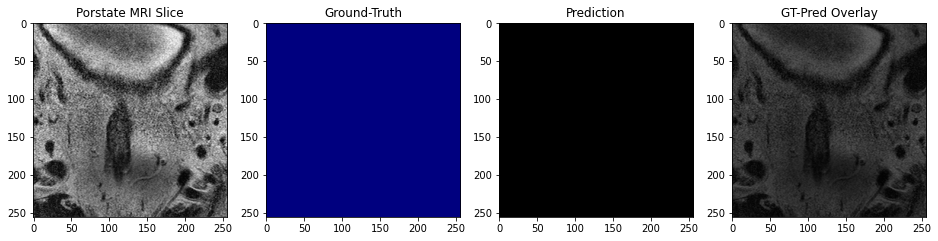

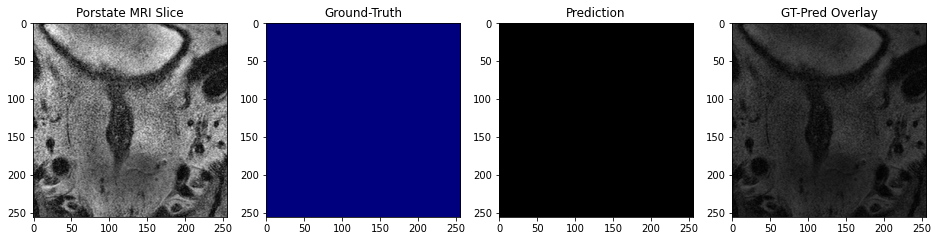

ProstateDx-03-0002_truth,    0.886,      8.124,      0.957,     -0.004,      0.001 
ProstateDx-03-0003_truth,    0.770,     27.037,      0.954,      0.017,     -0.008 
ProstateDx-03-0004_truth,    0.857,      8.602,      0.941,     -0.000,      0.000 
ProstateDx-03-0005_truth,    0.907,      6.000,      0.926,      0.067,     -0.003 
time elapsed for testing (hh:mm:ss.ms) 0:00:54.558932
***********************test-Prostate3T: Volumetric Quantification**************************

Name                   , Dice [%] ,    HD [mm], Sensitivity [%], Volume (ml), Err Volume(ml)  
Prostate3T-03-0001_truth,    0.860,      9.055,      0.851,     -0.000,     -0.000 


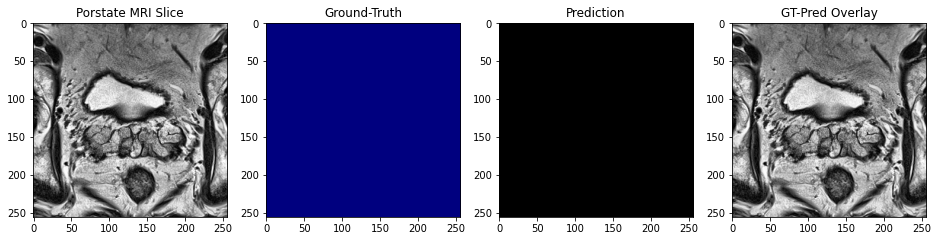

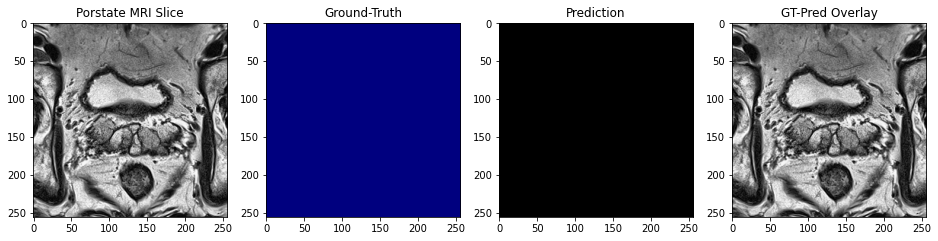

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


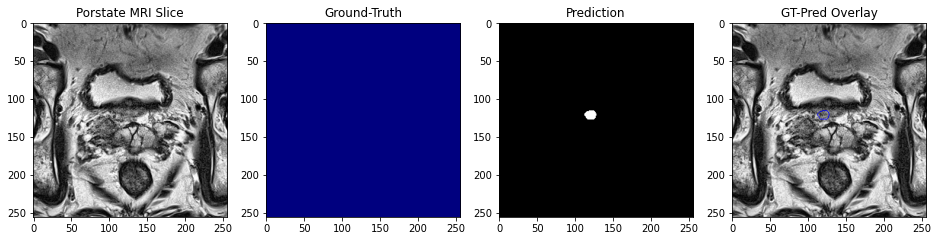

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


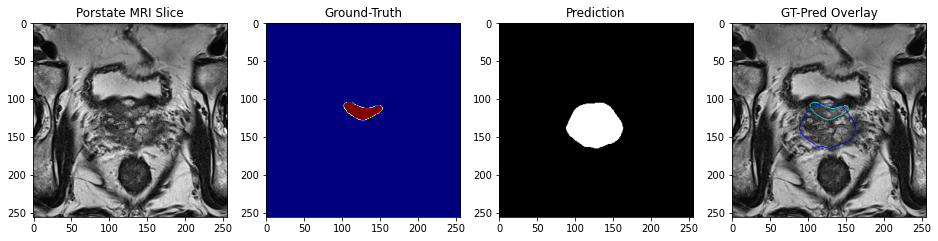

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


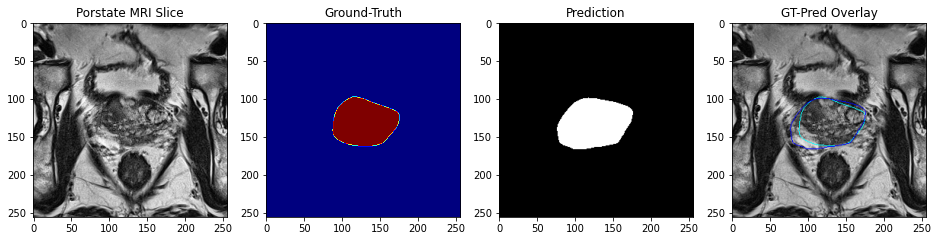

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


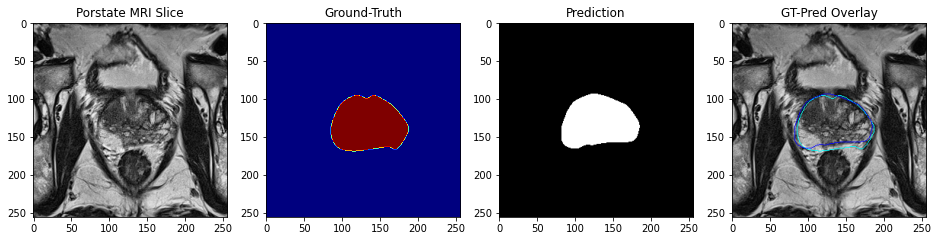

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


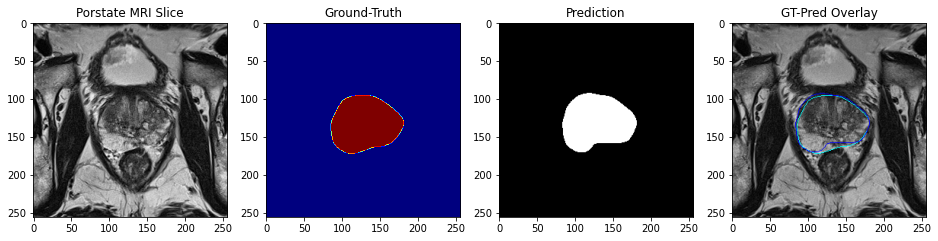

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


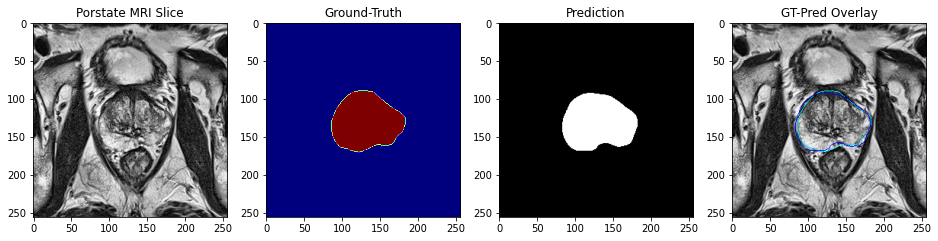

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


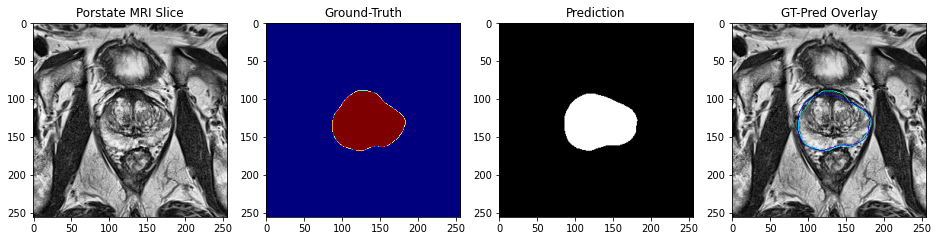

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


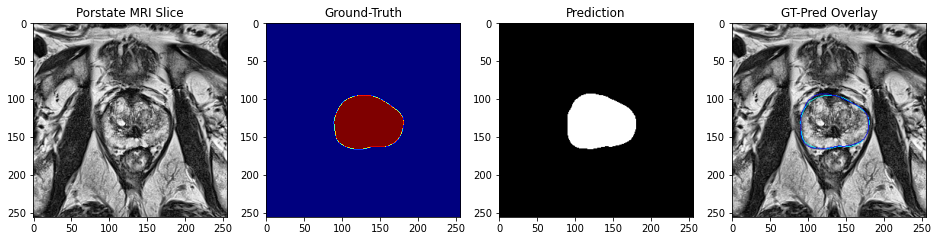

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


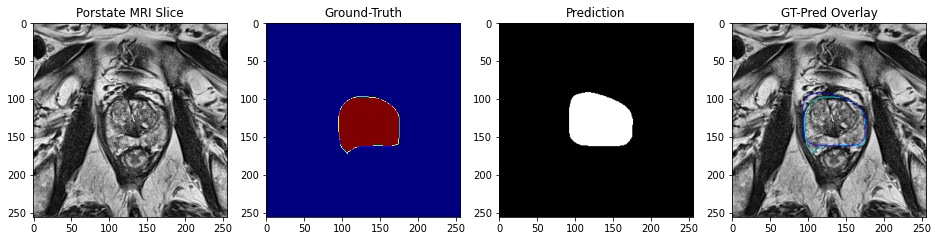

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


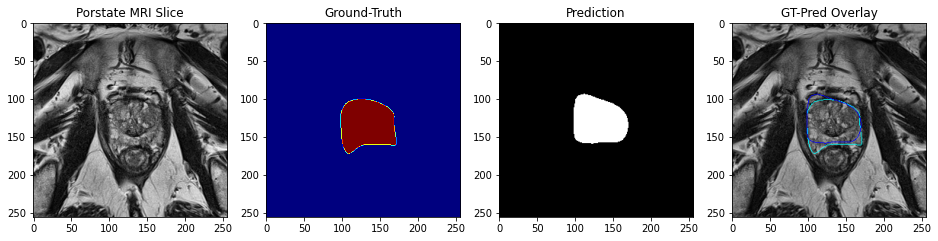

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


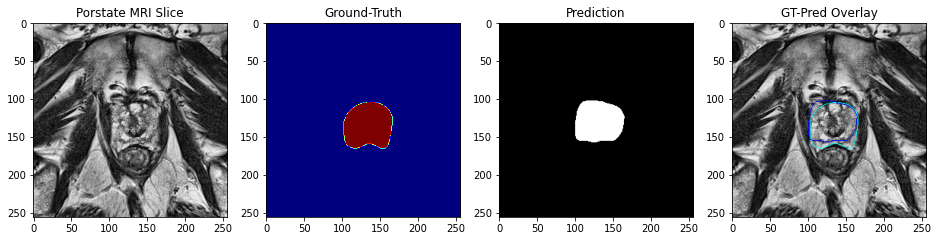

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


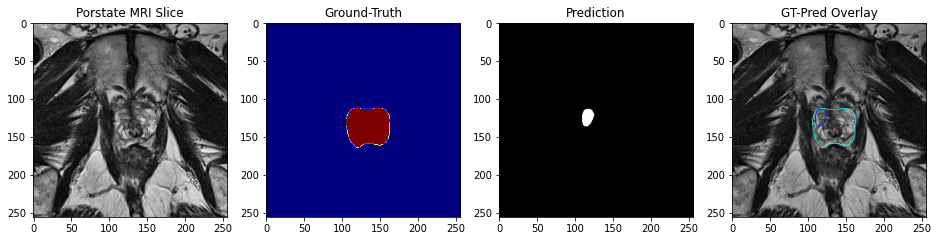

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


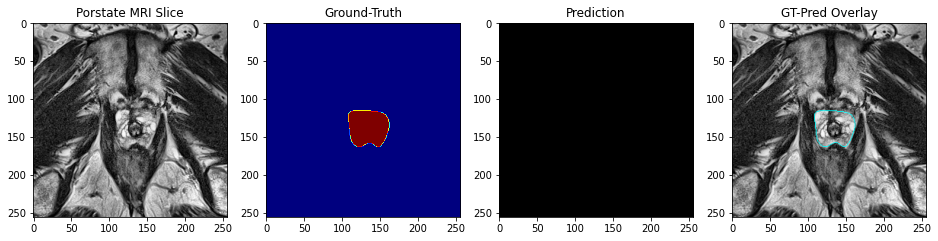

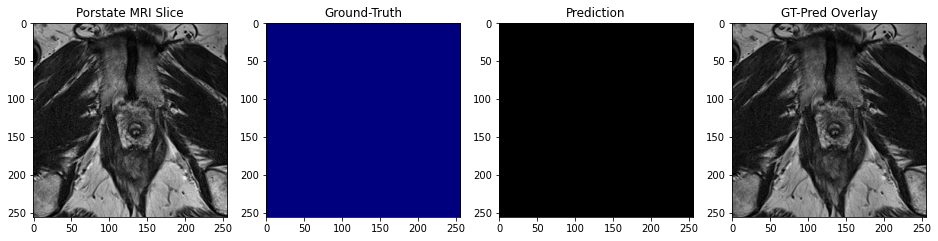

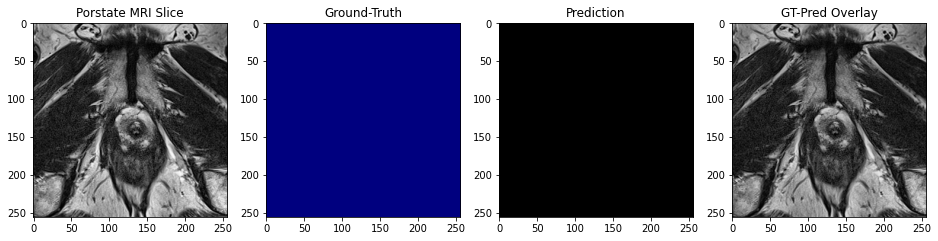

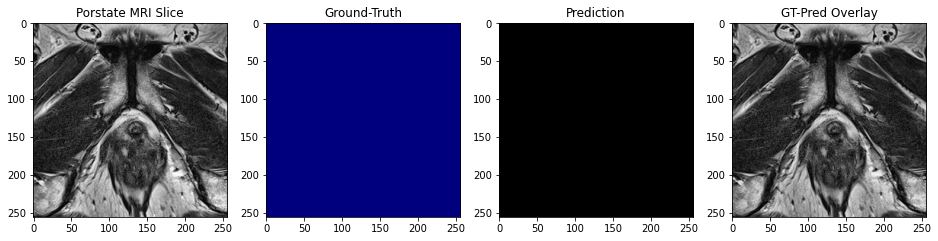

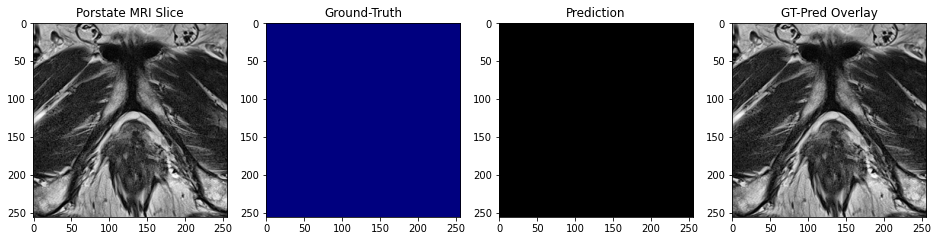

Prostate3T-03-0002_truth,    0.897,     12.083,      0.982,     -0.000,      0.000 
Prostate3T-03-0003_truth,    0.890,      6.403,      0.848,     -0.000,     -0.000 
Prostate3T-03-0004_truth,    0.883,     13.675,      0.919,     -0.000,      0.000 
Prostate3T-03-0005_truth,    0.696,     40.262,      0.942,     -0.000,      0.000 
time elapsed for testing (hh:mm:ss.ms) 0:00:29.303986
**********************************************************************************************************


In [140]:
config_info = "filters {}, n_block {}".format(n_filter, n_block)
print(config_info)

# calculate the comments
comments = "prostate_MRI.unet_lr_{}_{}".format(unetlr, n_filter)
if gaussianNoise:
    comments += ".gaussian_noise"
print(comments)

unet_model = Segmentation_model(filters=n_filter,
                                in_channels=1,
                                n_block=n_block,
                                bottleneck_depth=4,
                                n_class=n_class)
device = torch.device('cpu')
unet_model.load_state_dict(torch.load('../weights/{}/unet_model_checkpoint.pt'.format(comments), 
                                      map_location=device))


for dataset in ["valid", "test"]:
    for mr_type in ["PROSTATE-DIAGNOSIS", "Prostate-3T"]:
        compute_vol_metrics(unet_model, dataset, mr_type)

print("**********************************************************************************************************")

---
## 4.1 3D Suface Mesh Visualisation

To have a better understanding of model performance on detecting/segmenting porstate in MR images, we used ITK-Snap to visualise both ground-truth and model prediction segmentation.

Ground-Truth (prostateDx_03_0001)            |  Prediction (prostateDx_03_0001)
:-------------------------:|:-------------------------:
 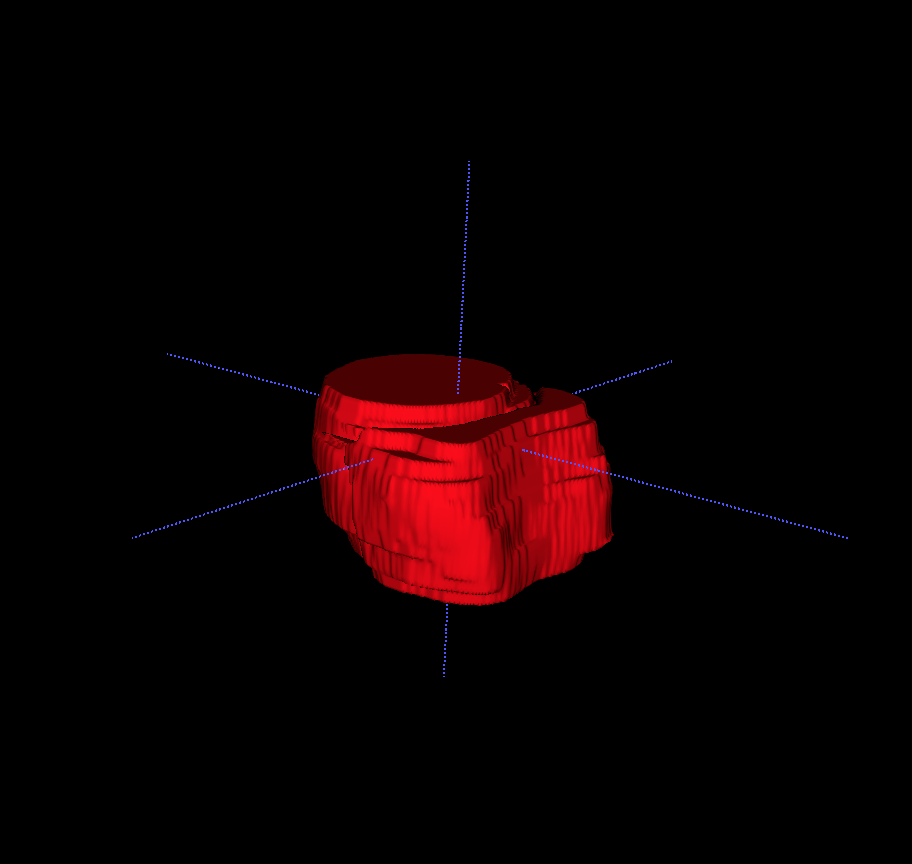| 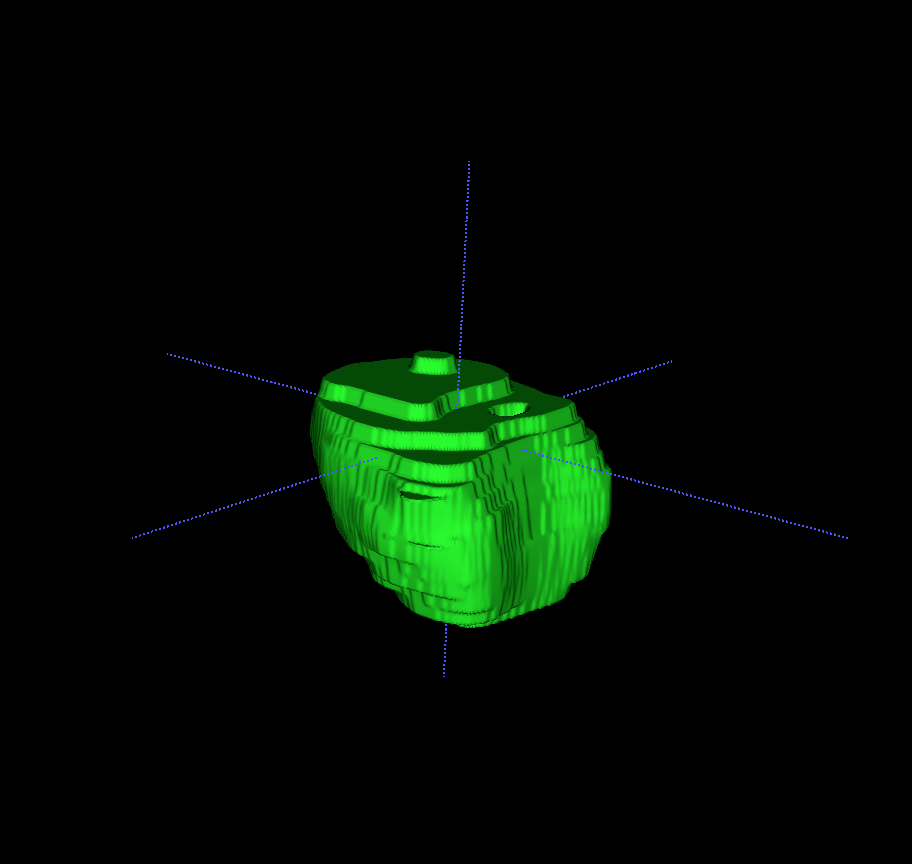

Ground-Truth (prostate3T_02_0003)            |  Prediction (prostate3T_02_0003)
:-------------------------:|:-------------------------:
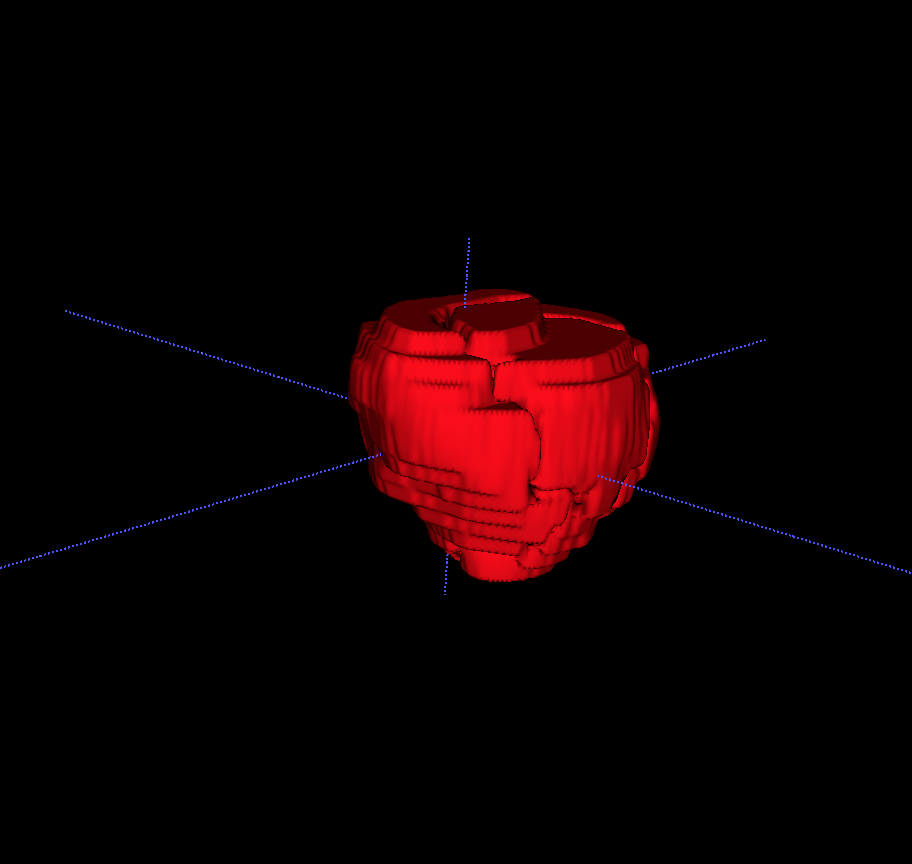|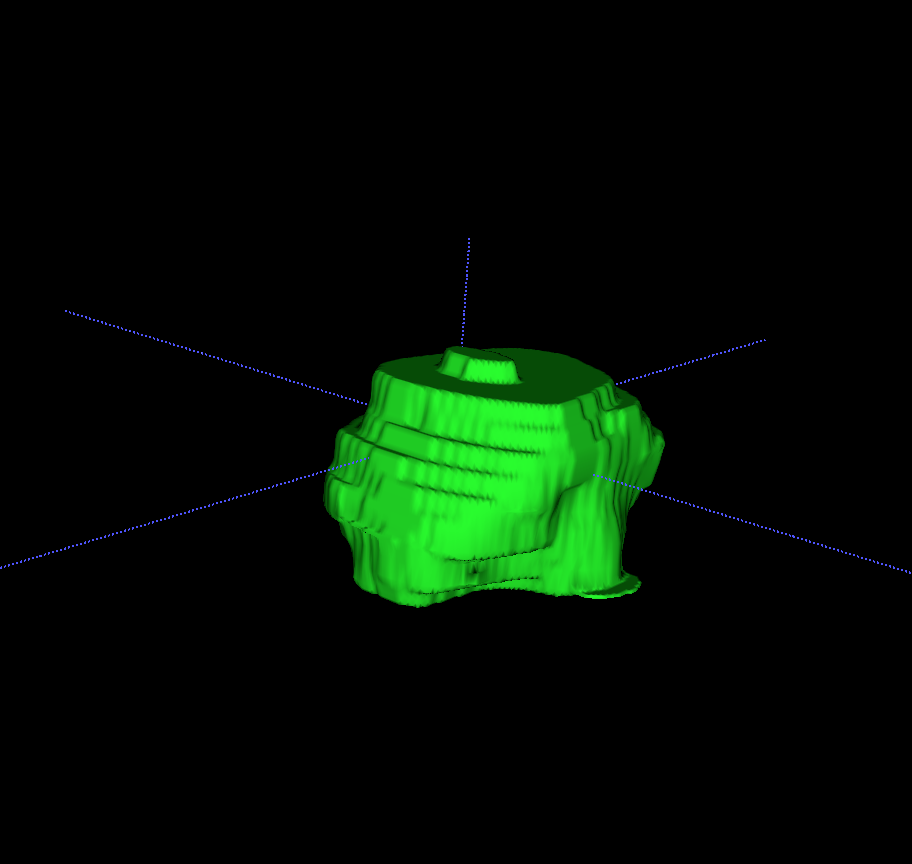